# Momentum and vorticity balance diagnostics - figures

In this notebook, we show:

* All terms of each momentum and vorticity balance, expressed in terms of horizontal transport balances by isolating the physical Coriolis force (momentum balances) or beta effect (vorticity balances)
* For each equation, the main dynamical balances, both at the grid scale and at large scale
* The relation between the depth-dependent and depth-integral momentum/vorticity balances

# 1. Preliminary settings

## Required modules and methods

In [1]:
#!/usr/bin/python3.7
# General:
%load_ext autoreload
%autoreload
import numpy as np
import xarray as xr
import sys
import os

# Plots
import matplotlib.pyplot as plt
from matplotlib.colors import BoundaryNorm
%matplotlib inline
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# Specific to the VoBiN package:
sys.path.append(os.path.abspath("../output"))
sys.path.append(os.path.abspath("../lib"))
from plot_methods import global_map,vertical_section,section_contour,global_quiver,global_contour,global_hatching,atl_line
from general_methods import norm,log10
from grid_methods import zint,search_lon,ubot,ucline,rolling_window

## Loading the data

In [2]:
names=['meshmask','utrd','utrd2','ztrd','ztrd2','ztrd_int','ztrd2_int','utrd2_int','utrd2_av','utrd2_transp',
       'utrd_int','utrd_av','utrd_transp','curl_utrd_int','curl_utrd2_int','curl_utrd_av','curl_utrd2_av',
       'curl_utrd_transp','curl_utrd2_transp','balances','balances_s']
for name in names:
    exec(name+'=xr.open_dataset("../output/'+name+'.nc")')

# derivation of |u|, vertical integral u, bottom |u| and a |u|-cline from (u,v) for interpretation purposes
u_norm=norm(utrd2.u,utrd2.v)
u_int=zint(utrd2.u,meshmask.e3u_0)
v_int=zint(utrd2.v,meshmask.e3v_0)
u_int_norm=norm(u_int,v_int)
u_int=u_int.rolling(x=2, min_periods=1).mean().rolling(y=2, min_periods=1).mean()*meshmask.umask.isel(lev=0)
v_int=v_int.rolling(x=2, min_periods=1).mean().rolling(y=2, min_periods=1).mean()*meshmask.vmask.isel(lev=0)
u_bot=ubot(u_norm,meshmask)
u_cline=ucline(u_norm,meshmask)

# 2. All terms of each balance

In [3]:
# Figure properties:
x=meshmask.fixed_glamt; x[-1,:]=x[-2,:]
y=meshmask.gphit
colorbar='plasma'
projection='Robinson'
rho0=1025
b=meshmask.beta
levs_ubot=[0.005,2]

## Depth-dependent momentum equation

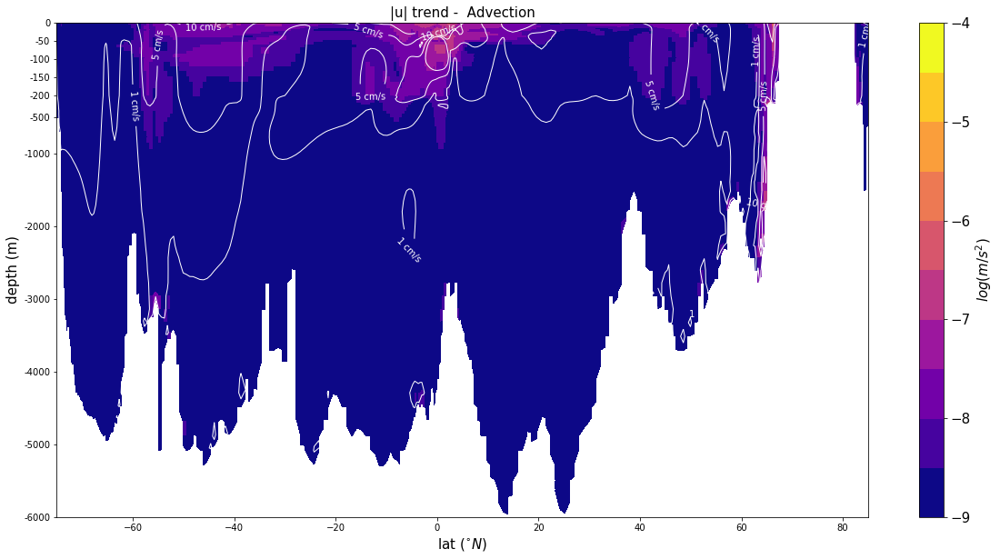

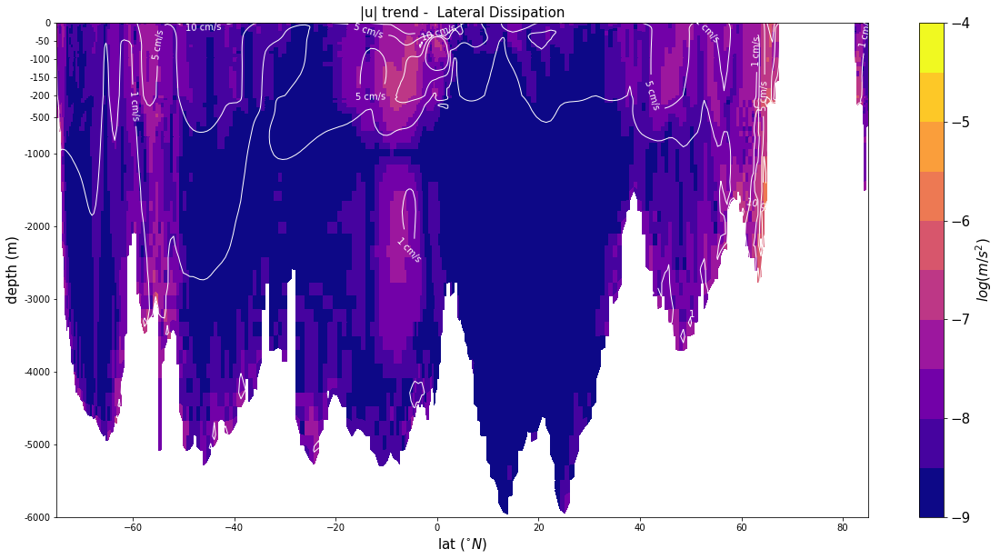

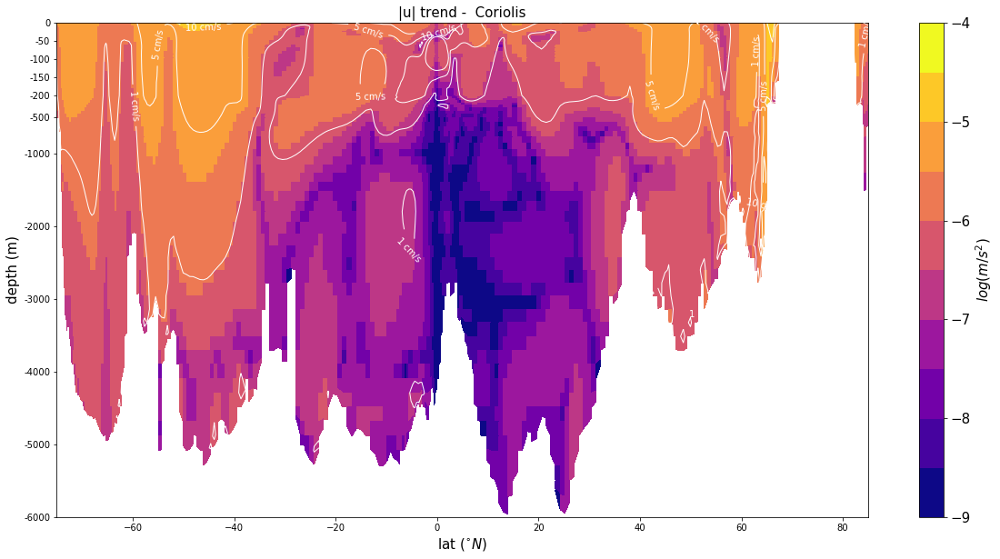

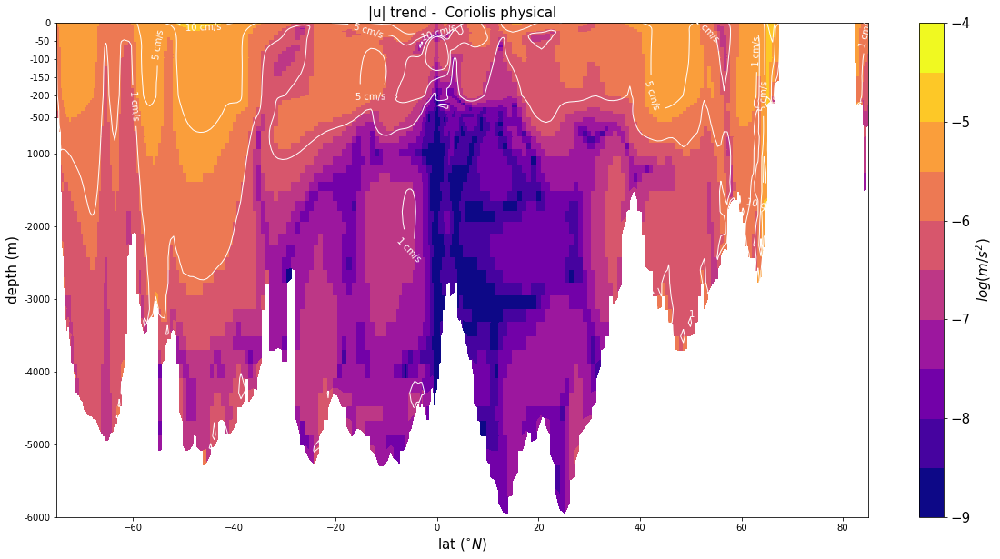

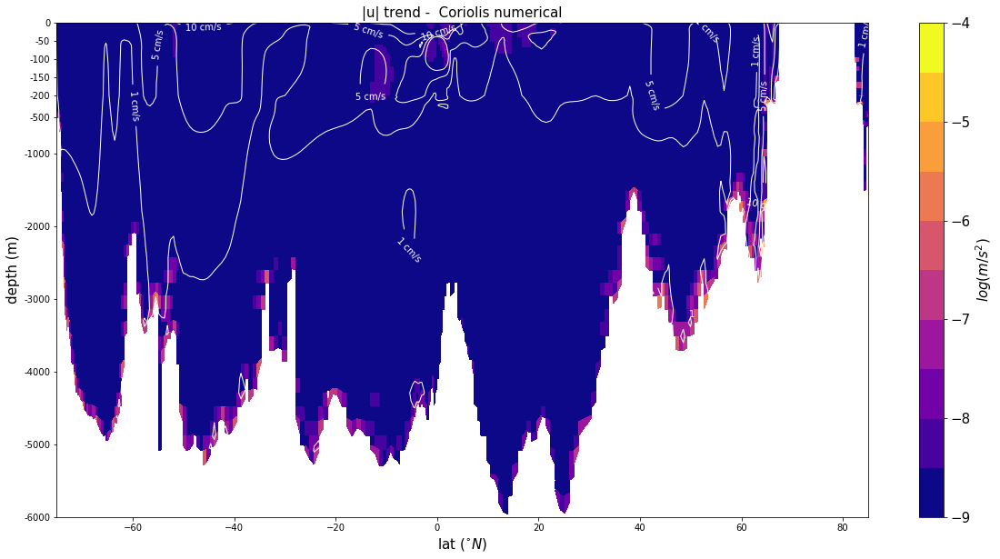

...

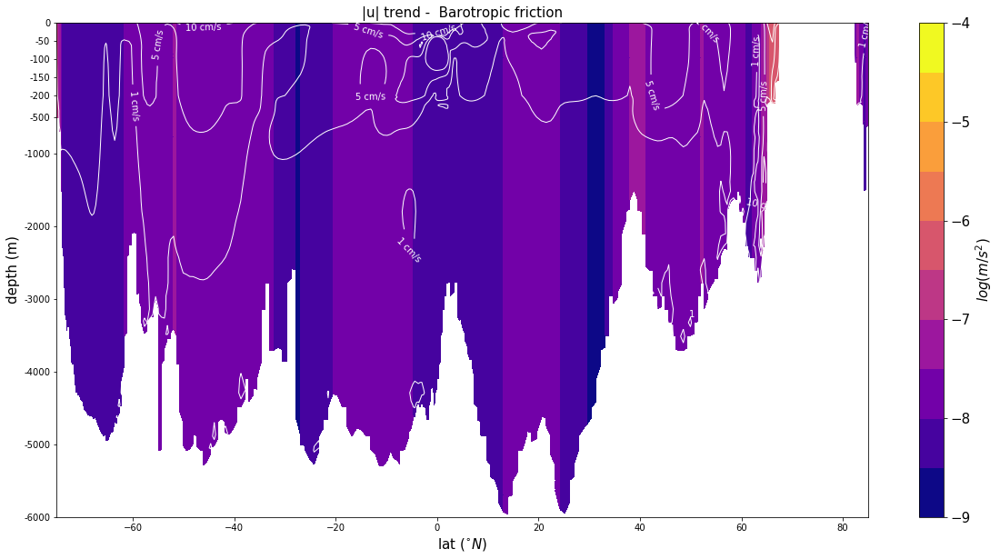

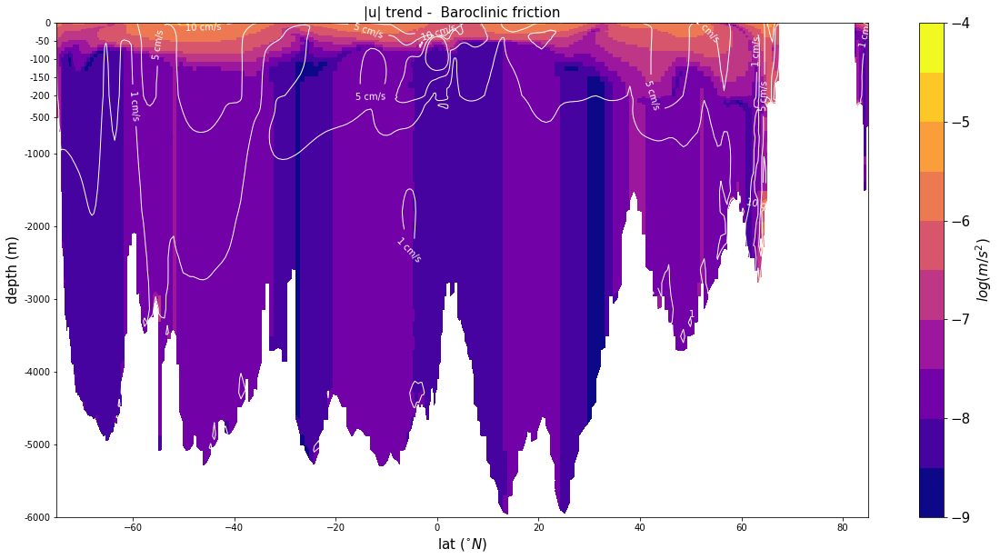

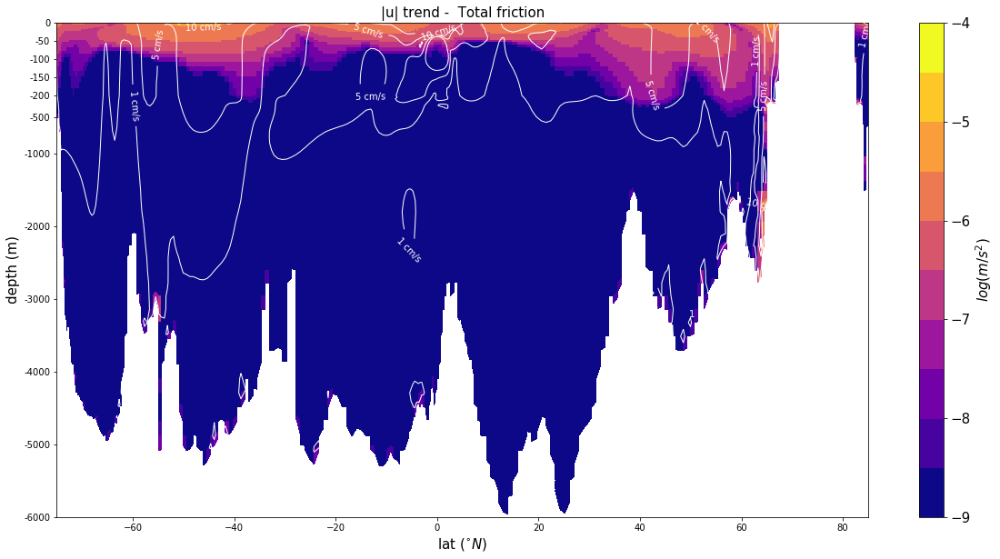

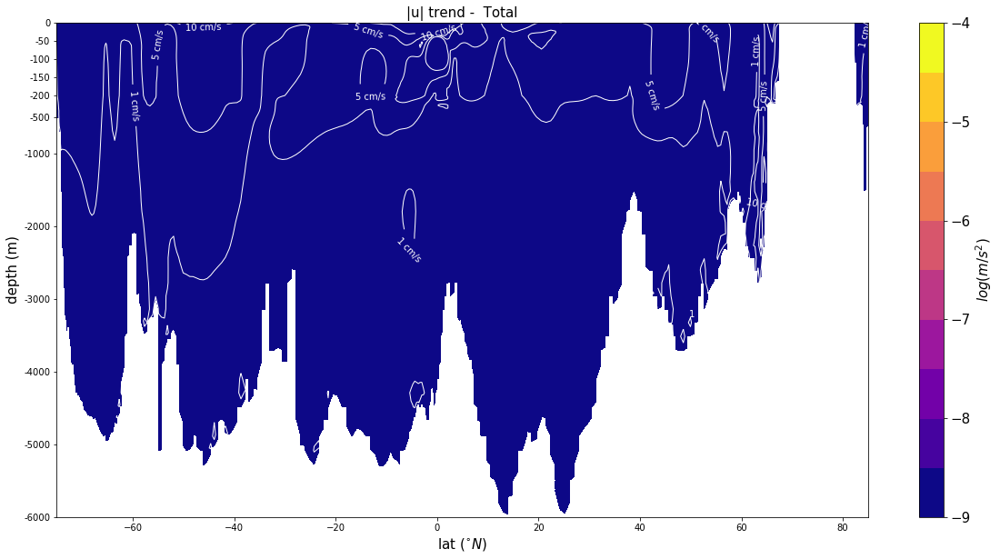

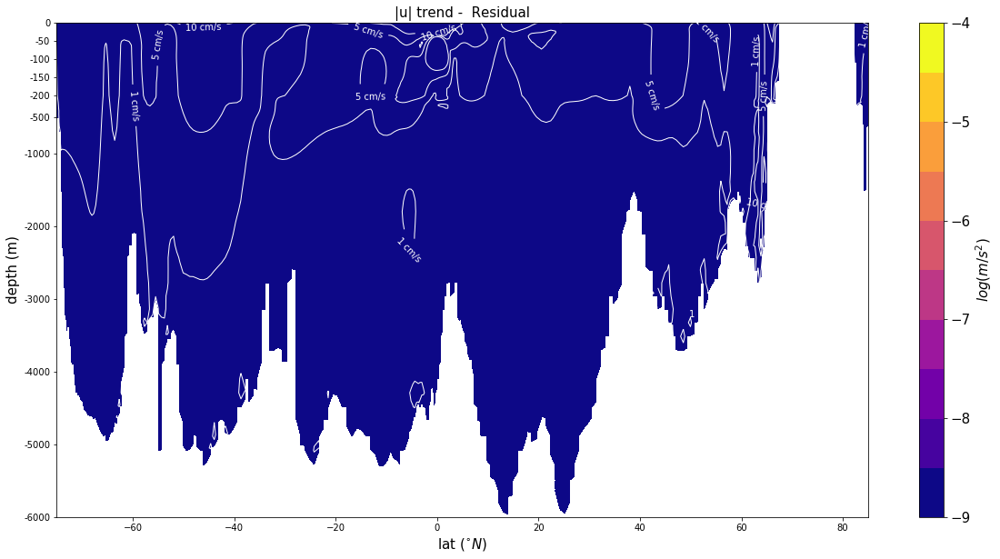

In [4]:
# Figure properties:
levs=np.linspace(-9,-4,11)
ylab='lat ($^{\circ}N$)'
zlab='depth (m)'
title='|u| trend - '
unit='$log(m/s^2)$'
file='U_budget_'
frame=[-75, 85, -6000, -0.5]
levs_u_norm=[1, 5, 10, 50]

# Selection of meridional cross-section over the Atlantic
ind_Atl=search_lon(-35,meshmask.glamt)
z_Atl=-meshmask.gdept_0.isel(x=ind_Atl)
y_Atl=xr.ones_like(z_Atl)*y.isel(x=ind_Atl)
z_Atl_stretch=z_Atl.copy()
z_Atl_stretch.data[z_Atl_stretch.data<-200]=-200+(z_Atl_stretch.data[z_Atl_stretch.data<-200]+200)/5
utrd_Atl=utrd.isel(x=ind_Atl)
utrd2_Atl=utrd2.isel(x=ind_Atl)
u_norm_Atl=u_norm.isel(x=ind_Atl)*100

# Advection
cbar=vertical_section(y_Atl,z_Atl,
    log10(norm(utrd_Atl.utrdkeg+utrd_Atl.utrdrvo+utrd_Atl.utrdzad,utrd_Atl.vtrdkeg+utrd_Atl.vtrdrvo+utrd_Atl.vtrdzad)),
    levs,unit,ylab,zlab,title+' Advection',colorbar,file+'adv',frame)
section_contour(y_Atl,z_Atl_stretch,u_norm_Atl,levs_u_norm,file+'adv')

# Lateral dissipation
cbar=vertical_section(y_Atl,z_Atl,
    log10(norm(utrd_Atl.utrdldf,utrd_Atl.vtrdldf)),
    levs,unit,ylab,zlab,title+' Lateral Dissipation',colorbar,file+'ldf',frame)
section_contour(y_Atl,z_Atl_stretch,u_norm_Atl,levs_u_norm,file+'ldf')

# Coriolis and its decomposition
cbar=vertical_section(y_Atl,z_Atl,
    log10(norm(utrd_Atl.utrdpvo,utrd_Atl.vtrdpvo)),
    levs,unit,ylab,zlab,title+' Coriolis',colorbar,file+'pvo',frame)
section_contour(y_Atl,z_Atl_stretch,u_norm_Atl,levs_u_norm,file+'pvo')

cbar=vertical_section(y_Atl,z_Atl,
    log10(norm(utrd2_Atl.utrdpvo_phys,utrd2_Atl.vtrdpvo_phys)),
    levs,unit,ylab,zlab,title+' Coriolis physical',colorbar,file+'pvo_phys',frame)
section_contour(y_Atl,z_Atl_stretch,u_norm_Atl,levs_u_norm,file+'pvo_phys')

cbar=vertical_section(y_Atl,z_Atl,
    log10(norm(utrd2_Atl.utrdpvo_num,utrd2_Atl.vtrdpvo_num)),
    levs,unit,ylab,zlab,title+' Coriolis numerical',colorbar,file+'pvo_num',frame)
section_contour(y_Atl,z_Atl_stretch,u_norm_Atl,levs_u_norm,file+'pvo_num')

# Pressure force
cbar=vertical_section(y_Atl,z_Atl,
    log10(norm(utrd_Atl.utrdhpg,utrd_Atl.vtrdhpg)),
    levs,unit,ylab,zlab,title+' Pressure force',colorbar,file+'pg',frame)
section_contour(y_Atl,z_Atl_stretch,u_norm_Atl,levs_u_norm,file+'pg')

# Barotropic trend (wind, bottom stress plus barotropic correction)
cbar=vertical_section(y_Atl,z_Atl,
    log10(norm(utrd_Atl.utrdspg,utrd_Atl.vtrdspg)),
    levs,unit,ylab,zlab,title+' Barotropic friction',colorbar,file+'zdfbt',frame)
section_contour(y_Atl,z_Atl_stretch,u_norm_Atl,levs_u_norm,file+'zdfbt')

# Baroclinic vertical friction
cbar=vertical_section(y_Atl,z_Atl,
    log10(norm(utrd_Atl.utrdzdf,utrd_Atl.vtrdzdf)),
    levs,unit,ylab,zlab,title+' Baroclinic friction',colorbar,file+'zdfbc',frame)
section_contour(y_Atl,z_Atl_stretch,u_norm_Atl,levs_u_norm,file+'zdfbc')

# Total vertical friction
cbar=vertical_section(y_Atl,z_Atl,
    log10(norm(utrd_Atl.utrdspg+utrd_Atl.utrdzdf,utrd_Atl.vtrdspg+utrd_Atl.vtrdzdf)),
    levs,unit,ylab,zlab,title+' Total friction',colorbar,file+'zdf',frame)
section_contour(y_Atl,z_Atl_stretch,u_norm_Atl,levs_u_norm,file+'zdf')

# Total trend
cbar=vertical_section(y_Atl,z_Atl,
    log10(norm(utrd_Atl.utrdtot,utrd_Atl.vtrdtot)),
    levs,unit,ylab,zlab,title+' Total',colorbar,file+'tot',frame)
section_contour(y_Atl,z_Atl_stretch,u_norm_Atl,levs_u_norm,file+'tot')

# Residual (Asselin time filter plus error)
cbar=vertical_section(y_Atl,z_Atl,
    log10(norm(utrd_Atl.utrdtot-(utrd_Atl.utrdkeg+utrd_Atl.utrdrvo+utrd_Atl.utrdzad+utrd_Atl.utrdldf+utrd_Atl.utrdpvo+utrd_Atl.utrdhpg+utrd_Atl.utrdspg+utrd_Atl.utrdzdf),
         utrd_Atl.vtrdtot-(utrd_Atl.vtrdkeg+utrd_Atl.vtrdrvo+utrd_Atl.vtrdzad+utrd_Atl.vtrdldf+utrd_Atl.vtrdpvo+utrd_Atl.vtrdhpg+utrd_Atl.vtrdspg+utrd_Atl.vtrdzdf))),
    levs,unit,ylab,zlab,title+' Residual',colorbar,file+'res',frame)
section_contour(y_Atl,z_Atl_stretch,u_norm_Atl,levs_u_norm,file+'res')

## Depth-dependent vorticity equation

/usr/lib/python3/dist-packages/xarray/core/computation.py:604: RuntimeWarning: divide by zero encountered in log
  result_data = func(*input_data)


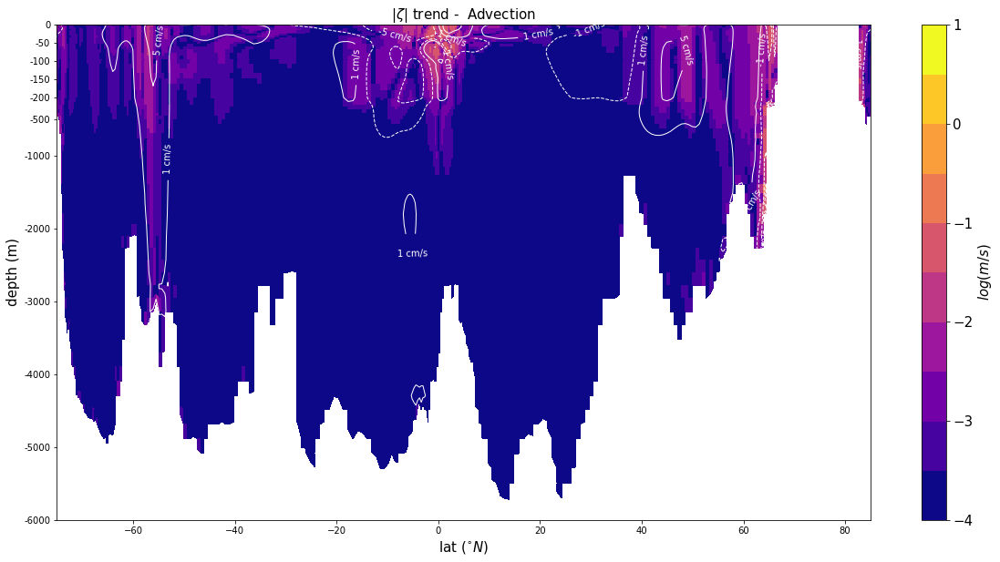

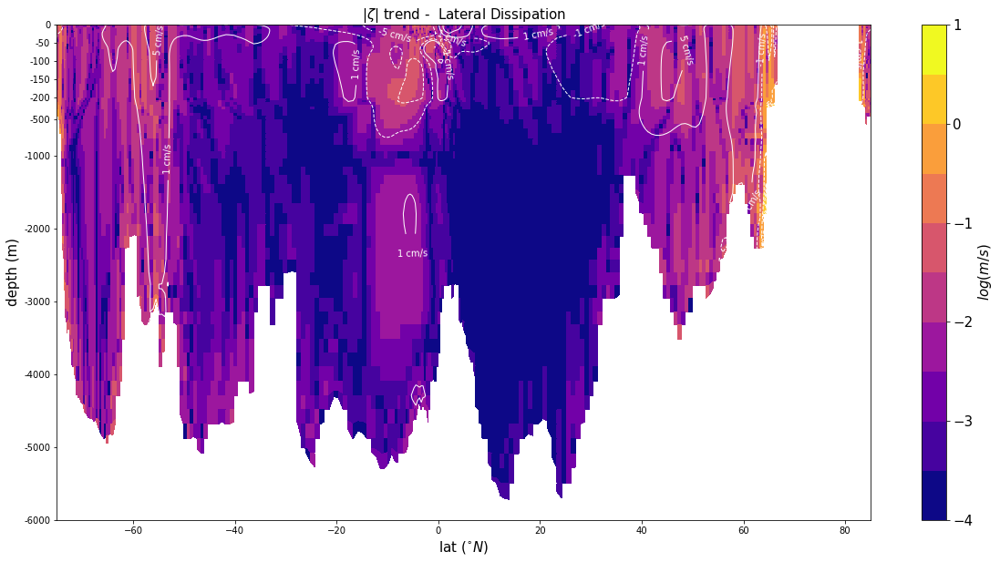

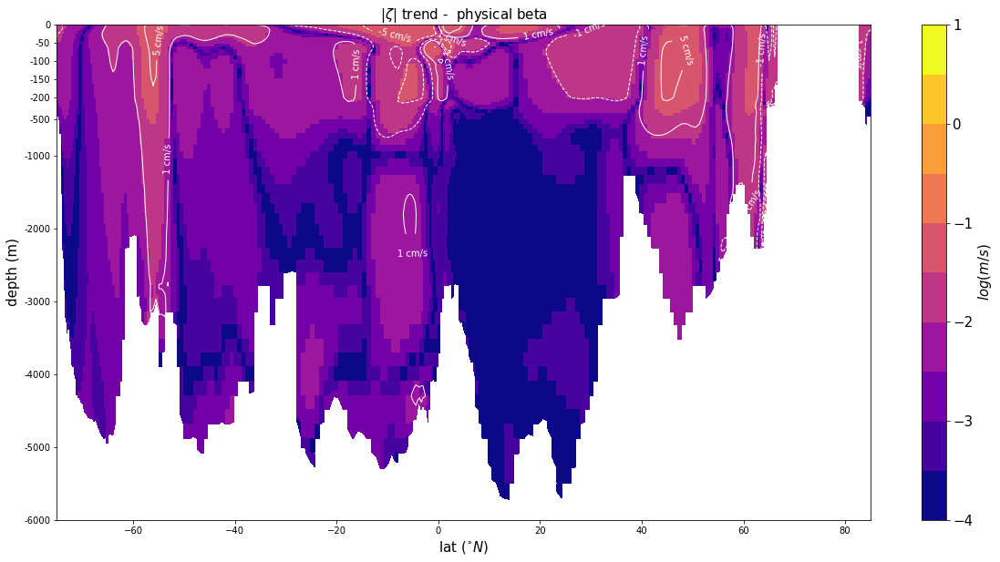

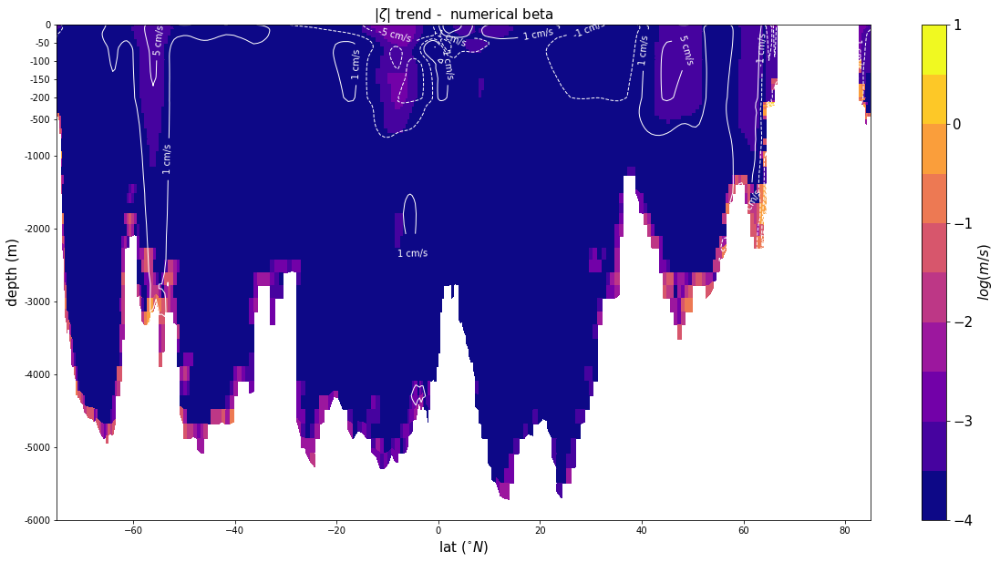

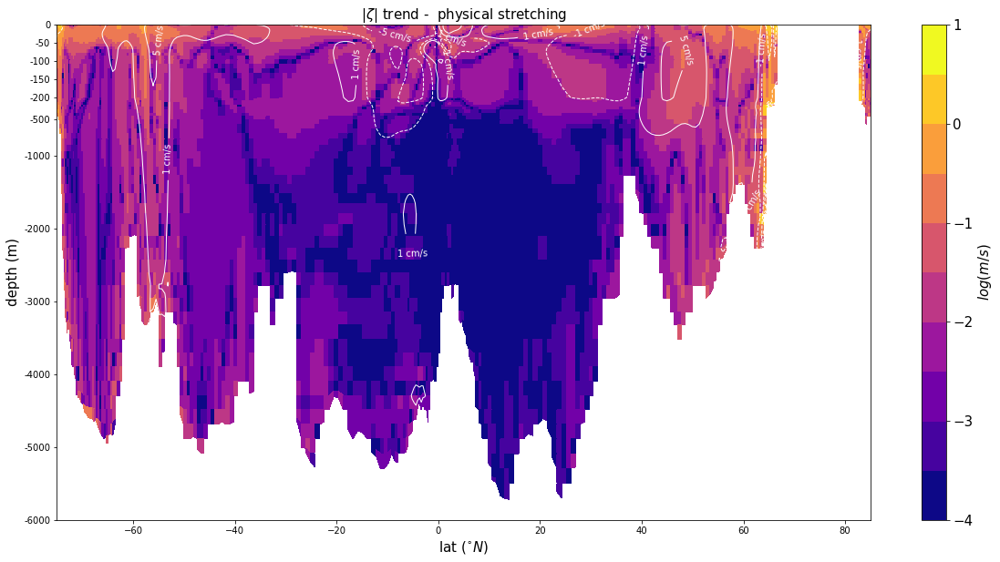

...

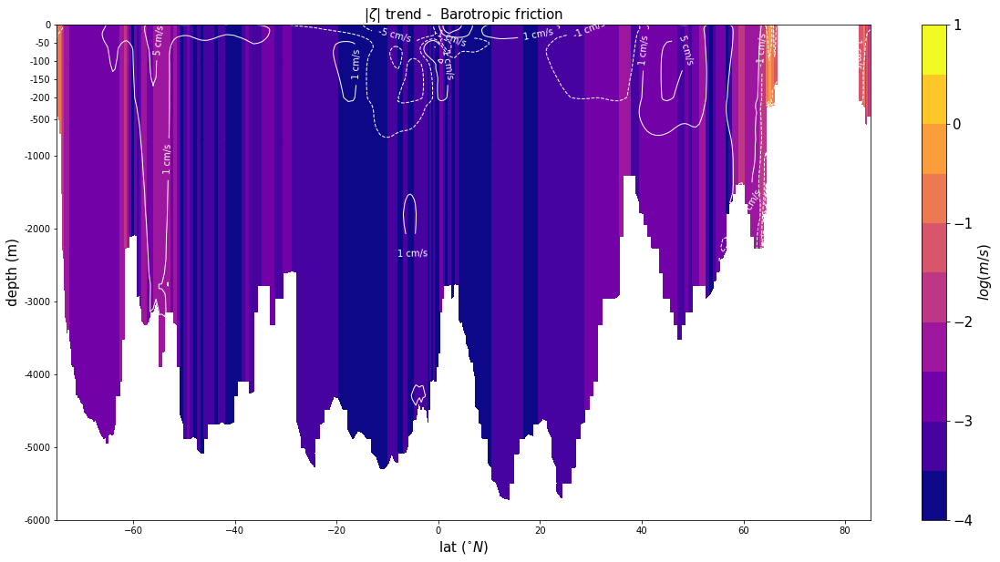

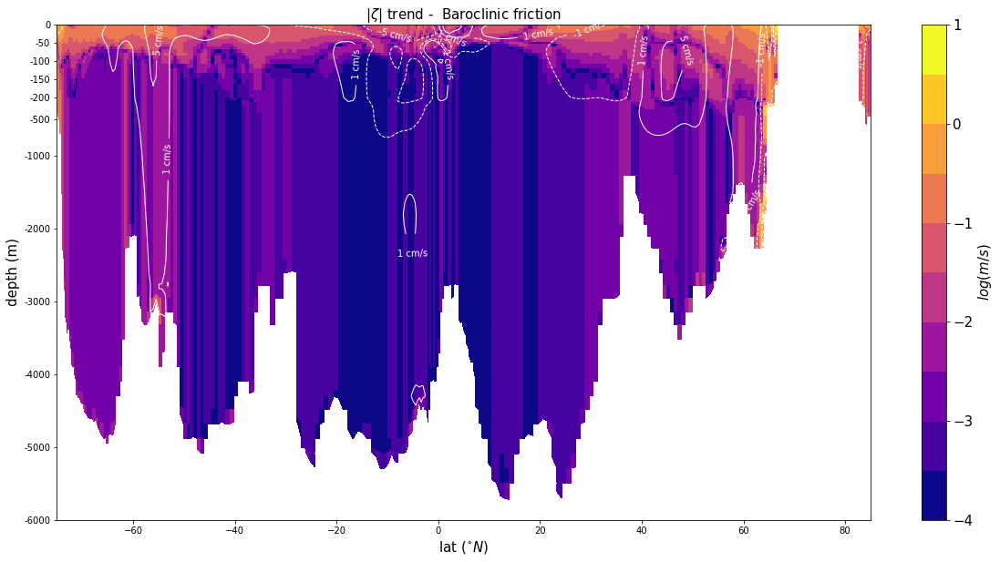

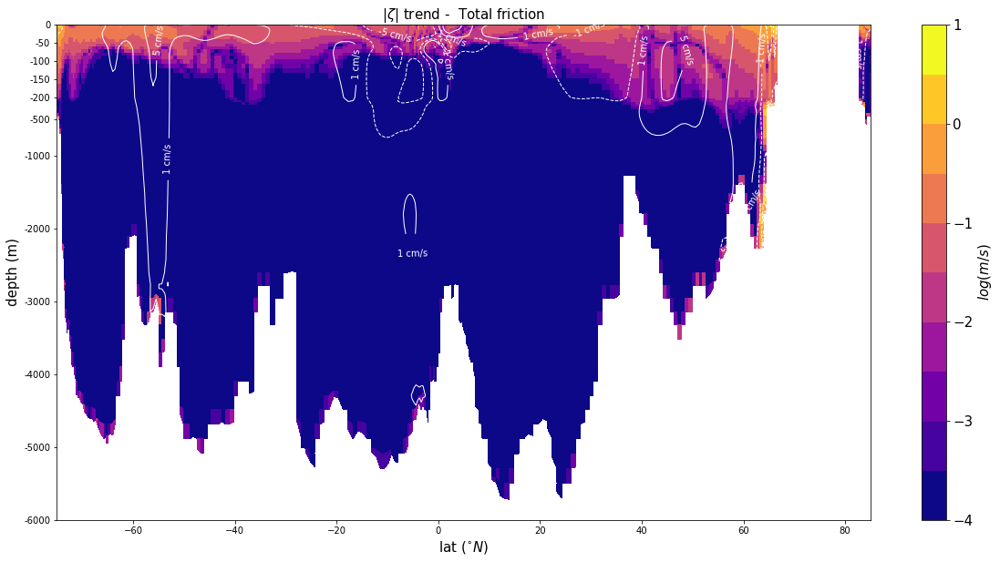

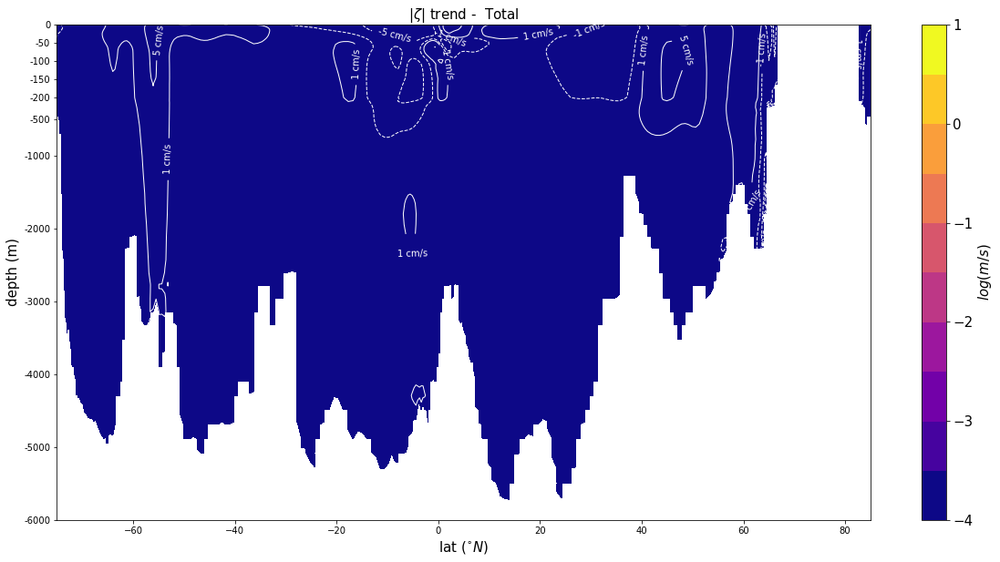

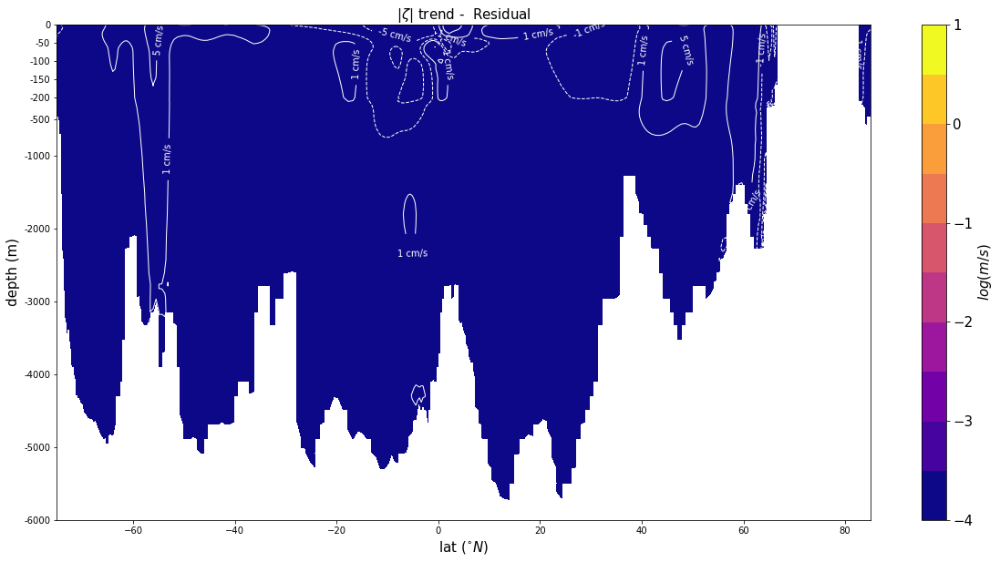

In [5]:
# Figure properties:
levs=np.linspace(-4,1,11)
title='|$\zeta$| trend - '
unit='$log(m/s)$'
file='Z_budget_'
frame=[-75, 85, -6000, -0.5]
levs_v_yz=[-50, -10, -5, -1, 1, 5, 10, 50]

# Selection of meridional cross-section over the Atlantic
ztrd_Atl=ztrd.isel(x=ind_Atl)
ztrd2_Atl=ztrd2.isel(x=ind_Atl)
b_Atl=b.isel(x=ind_Atl)
v_Atl=utrd2.v.isel(x=ind_Atl)*100

# Advection
cbar=vertical_section(y_Atl,z_Atl,
    log10(abs(ztrd_Atl.ztrdkeg+ztrd_Atl.ztrdrvo+ztrd_Atl.ztrdzad)/b_Atl),
    levs,unit,ylab,zlab,title+' Advection',colorbar,file+'adv',frame)
section_contour(y_Atl,z_Atl_stretch,v_Atl,levs_v_yz,file+'adv')

# Lateral dissipation
cbar=vertical_section(y_Atl,z_Atl,
    log10(abs(ztrd_Atl.ztrdldf)/b_Atl),
    levs,unit,ylab,zlab,title+' Lateral Dissipation',colorbar,file+'ldf',frame)
section_contour(y_Atl,z_Atl_stretch,v_Atl,levs_v_yz,file+'ldf')

# Coriolis and its decomposition
cbar=vertical_section(y_Atl,z_Atl,
    log10(abs(ztrd2_Atl.ztrd_betaphys)/b_Atl),
    levs,unit,ylab,zlab,title+' physical beta',colorbar,file+'beta_phys',frame)
section_contour(y_Atl,z_Atl_stretch,v_Atl,levs_v_yz,file+'beta_phys')

cbar=vertical_section(y_Atl,z_Atl,
    log10(abs(ztrd2_Atl.ztrd_betanum)/b_Atl),
    levs,unit,ylab,zlab,title+' numerical beta',colorbar,file+'beta_num',frame)
section_contour(y_Atl,z_Atl_stretch,v_Atl,levs_v_yz,file+'beta_num')

cbar=vertical_section(y_Atl,z_Atl,
    log10(abs(ztrd2_Atl.ztrd_stretchphys)/b_Atl),
    levs,unit,ylab,zlab,title+' physical stretching',colorbar,file+'stretch_phys',frame)
section_contour(y_Atl,z_Atl_stretch,v_Atl,levs_v_yz,file+'stretch_phys')

cbar=vertical_section(y_Atl,z_Atl,
    log10(abs(ztrd2_Atl.ztrd_topo_stretch)/b_Atl),
    levs,unit,ylab,zlab,title+' topographic stretching',colorbar,file+'stretch_topo',frame)
section_contour(y_Atl,z_Atl_stretch,v_Atl,levs_v_yz,file+'stretch_topo')

cbar=vertical_section(y_Atl,z_Atl,
    log10(abs(ztrd2_Atl.ztrd_stretchphys-ztrd2_Atl.ztrd_topo_stretch)/b_Atl),
    levs,unit,ylab,zlab,title+' interior stretching',colorbar,file+'stretch_interior',frame)
section_contour(y_Atl,z_Atl_stretch,v_Atl,levs_v_yz,file+'stretch_interior')

cbar=vertical_section(y_Atl,z_Atl,
    log10(abs(ztrd2_Atl.ztrd_stretchnum)/b_Atl),
    levs,unit,ylab,zlab,title+' numerical stretching',colorbar,file+'stretch_num',frame)
section_contour(y_Atl,z_Atl_stretch,v_Atl,levs_v_yz,file+'stretch_num')

cbar=vertical_section(y_Atl,z_Atl,
    log10(abs(ztrd2_Atl.ztrd_betanum+ztrd2_Atl.ztrd_stretchnum)/b_Atl),
    levs,unit,ylab,zlab,title+' numerical',colorbar,file+'num',frame)
section_contour(y_Atl,z_Atl_stretch,v_Atl,levs_v_yz,file+'num')

# Pressure force
cbar=vertical_section(y_Atl,z_Atl,
    log10(abs(ztrd_Atl.ztrdhpg)/b_Atl),
    levs,unit,ylab,zlab,title+' Pressure force',colorbar,file+'pg',frame)
section_contour(y_Atl,z_Atl_stretch,v_Atl,levs_v_yz,file+'pg')

# Barotropic trend (wind, bottom stress plus barotropic correction)
cbar=vertical_section(y_Atl,z_Atl,
    log10(abs(ztrd_Atl.ztrdspg)/b_Atl),
    levs,unit,ylab,zlab,title+' Barotropic friction',colorbar,file+'bt',frame)
section_contour(y_Atl,z_Atl_stretch,v_Atl,levs_v_yz,file+'bt')

# Baroclinic vertical friction
cbar=vertical_section(y_Atl,z_Atl,
    log10(abs(ztrd_Atl.ztrdzdf)/b_Atl),
    levs,unit,ylab,zlab,title+' Baroclinic friction',colorbar,file+'zdfbc',frame)
section_contour(y_Atl,z_Atl_stretch,v_Atl,levs_v_yz,file+'zdfbc')

# Total vertical friction
cbar=vertical_section(y_Atl,z_Atl,
    log10(abs(ztrd_Atl.ztrdspg+ztrd_Atl.ztrdzdf)/b_Atl),
    levs,unit,ylab,zlab,title+' Total friction',colorbar,file+'zdf',frame)
section_contour(y_Atl,z_Atl_stretch,v_Atl,levs_v_yz,file+'zdf')

# Total trend
cbar=vertical_section(y_Atl,z_Atl,
    log10(abs(ztrd_Atl.ztrdtot)/b_Atl),
    levs,unit,ylab,zlab,title+' Total',colorbar,file+'tot',frame)
section_contour(y_Atl,z_Atl_stretch,v_Atl,levs_v_yz,file+'tot')

# Residual (Asselin time filter plus error)
cbar=vertical_section(y_Atl,z_Atl,
    log10(abs(ztrd_Atl.ztrdtot-(ztrd_Atl.ztrdkeg+ztrd_Atl.ztrdrvo+ztrd_Atl.ztrdzad+ztrd_Atl.ztrdldf+ztrd_Atl.ztrdpvo+ztrd_Atl.ztrdhpg+ztrd_Atl.ztrdspg+ztrd_Atl.ztrdzdf))/b_Atl),
    levs,unit,ylab,zlab,title+' Residual',colorbar,file+'res',frame)
section_contour(y_Atl,z_Atl_stretch,v_Atl,levs_v_yz,file+'res')

## Depth-integral momentum equation

/home/waldmanr/Bureau/Model/VoBiN/plot/plot_methods.py:65: RuntimeWarning: invalid value encountered in less
  u_rot, v_rot = proj.transform_vectors(src_crs,x,y,u/np.cos(y/180*np.pi),v)
/home/waldmanr/Bureau/Model/VoBiN/plot/plot_methods.py:65: RuntimeWarning: invalid value encountered in greater
  u_rot, v_rot = proj.transform_vectors(src_crs,x,y,u/np.cos(y/180*np.pi),v)
/home/waldmanr/Bureau/Model/VoBiN/plot/plot_methods.py:66: RuntimeWarning: invalid value encountered in true_divide
  renorm = np.sqrt((u**2 + v**2) / (u_rot**2 + v_rot**2))
/usr/lib/python3/dist-packages/cartopy/mpl/geoaxes.py:1752: RuntimeWarning: invalid value encountered in less
  u, v = self.projection.transform_vectors(t, x, y, u, v)
/usr/lib/python3/dist-packages/cartopy/mpl/geoaxes.py:1752: RuntimeWarning: invalid value encountered in greater
  u, v = self.projection.transform_vectors(t, x, y, u, v)
/home/waldmanr/Bureau/Model/VoBiN/plot/plot_methods.py:65: RuntimeWarning: invalid value encountered in less
  u

/home/waldmanr/Bureau/Model/VoBiN/plot/plot_methods.py:65: RuntimeWarning: invalid value encountered in less
  u_rot, v_rot = proj.transform_vectors(src_crs,x,y,u/np.cos(y/180*np.pi),v)
/home/waldmanr/Bureau/Model/VoBiN/plot/plot_methods.py:65: RuntimeWarning: invalid value encountered in greater
  u_rot, v_rot = proj.transform_vectors(src_crs,x,y,u/np.cos(y/180*np.pi),v)
/home/waldmanr/Bureau/Model/VoBiN/plot/plot_methods.py:66: RuntimeWarning: invalid value encountered in true_divide
  renorm = np.sqrt((u**2 + v**2) / (u_rot**2 + v_rot**2))
/usr/lib/python3/dist-packages/cartopy/mpl/geoaxes.py:1752: RuntimeWarning: invalid value encountered in less
  u, v = self.projection.transform_vectors(t, x, y, u, v)
/usr/lib/python3/dist-packages/cartopy/mpl/geoaxes.py:1752: RuntimeWarning: invalid value encountered in greater
  u, v = self.projection.transform_vectors(t, x, y, u, v)
/home/waldmanr/Bureau/Model/VoBiN/plot/plot_methods.py:65: RuntimeWarning: invalid value encountered in less
  u

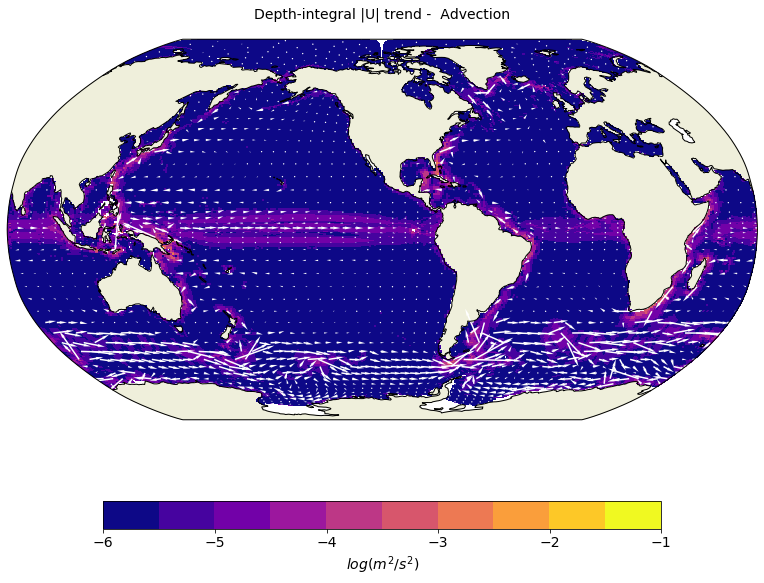

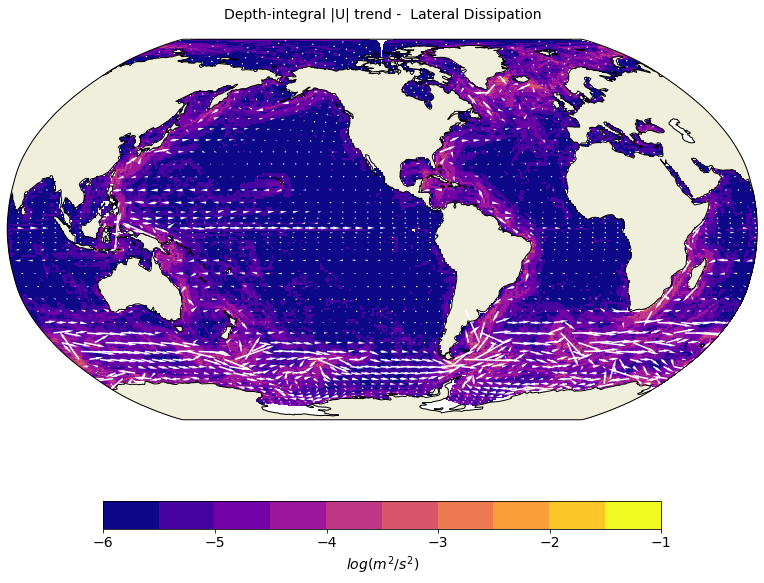

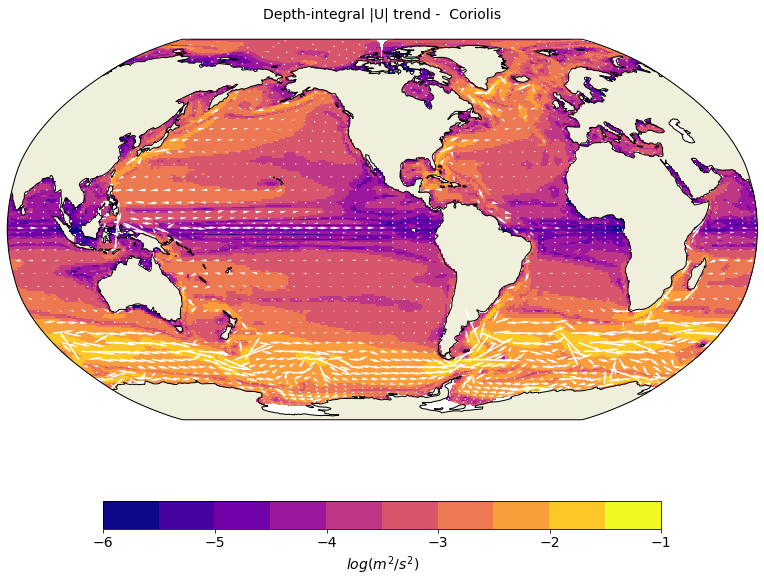

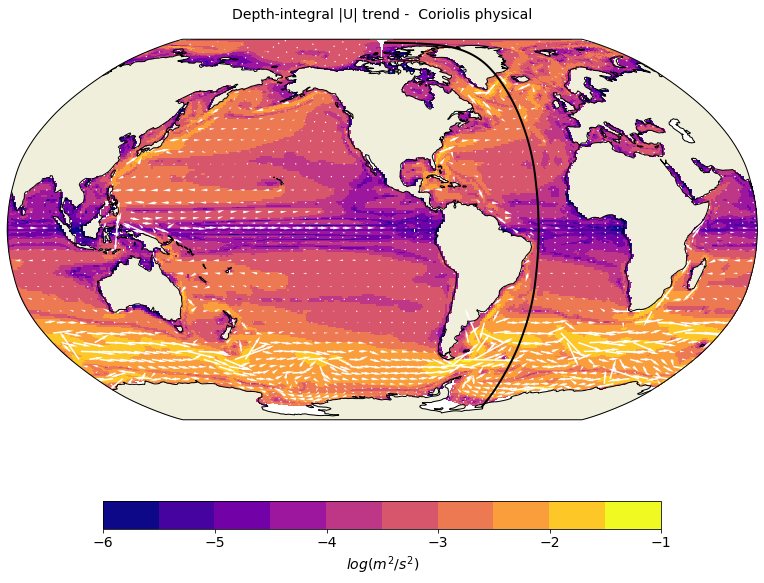

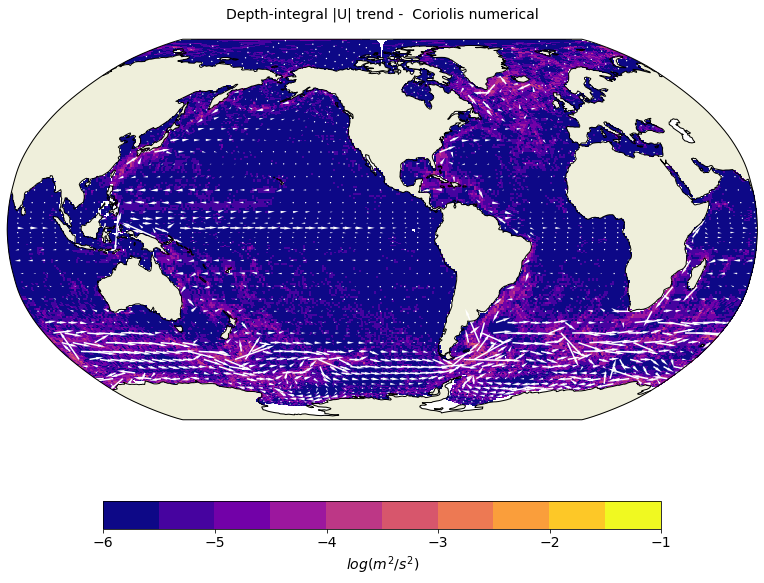

...

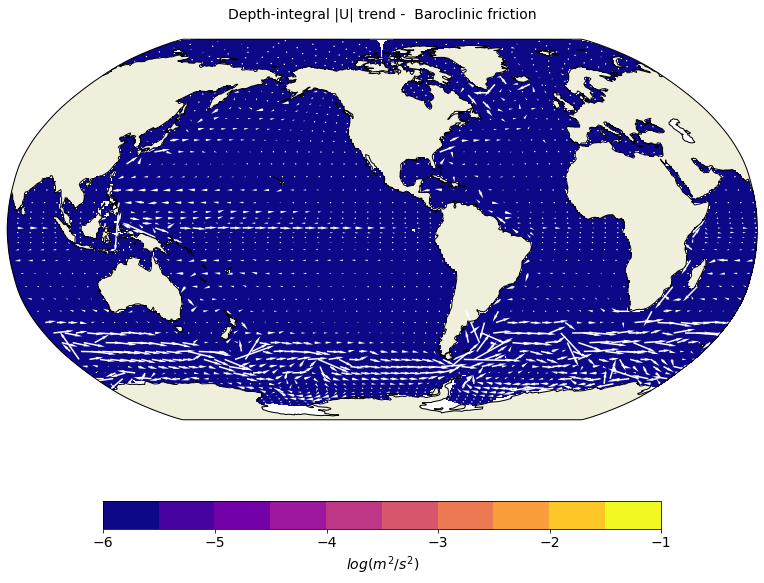

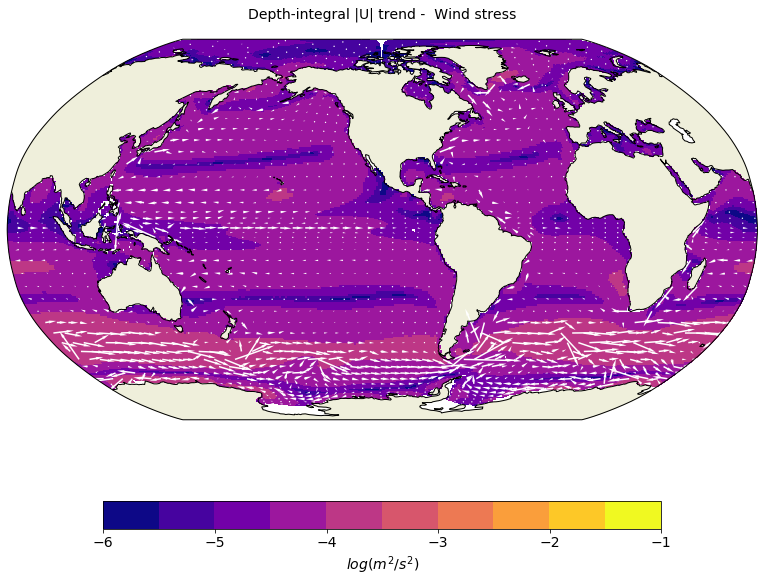

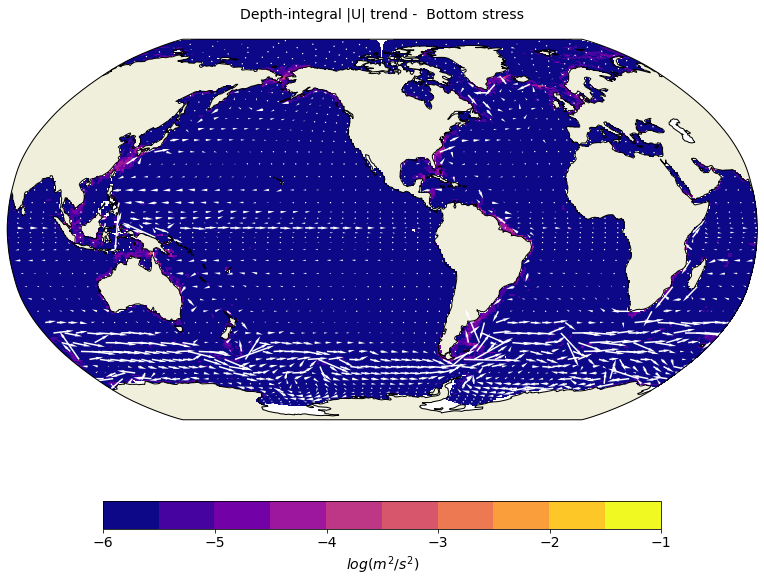

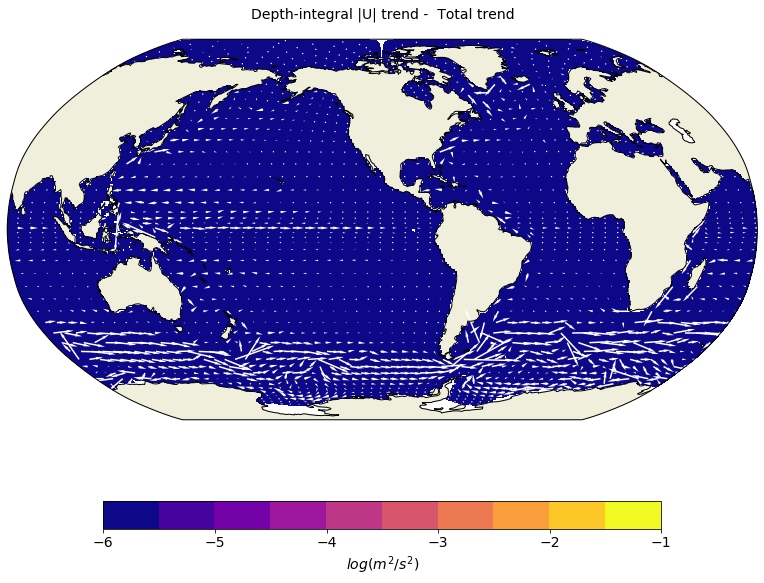

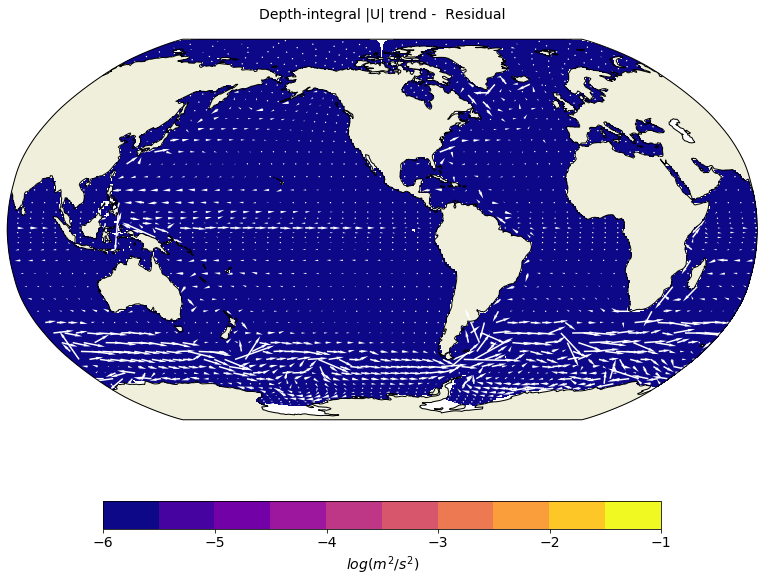

In [6]:
# Figure properties:
levs=np.linspace(-6,-1,11)
unit='$log(m^2/s^2)$'
title='Depth-integral |U| trend - '
file='U_budget_int_'
x_Atl=xr.ones_like(z_Atl)*x.isel(x=ind_Atl)

# Advection
ax,cbar=ax,cbar=global_map(x,y,log10(norm(utrd_int.utrdkeg+utrd_int.utrdrvo+utrd_int.utrdzad,utrd_int.vtrdkeg+utrd_int.vtrdrvo+utrd_int.vtrdzad)),
           levs,unit,title+' Advection',colorbar,file+'adv',projection)
global_quiver(ax,x,y,u_int,v_int,file+'adv','w')

# Lateral dissipation
ax,cbar=global_map(x,y,log10(norm(utrd_int.utrdldf,utrd_int.vtrdldf)),
           levs,unit,title+' Lateral Dissipation',colorbar,file+'ldf',projection)
global_quiver(ax,x,y,u_int,v_int,file+'ldf','w')

# Coriolis and its decomposition
ax,cbar=global_map(x,y,log10(norm(utrd_int.utrdpvo,utrd_int.vtrdpvo)),
           levs,unit,title+' Coriolis',colorbar,file+'pvo',projection)
global_quiver(ax,x,y,u_int,v_int,file+'pvo','w')

ax,cbar=global_map(x,y,log10(norm(utrd2_int.utrdpvo_phys,utrd2_int.vtrdpvo_phys)),
           levs,unit,title+' Coriolis physical',colorbar,file+'pvo_phys',projection)
global_quiver(ax,x,y,u_int,v_int,file+'pvo_phys','w')
atl_line(ax,x_Atl.isel(lev=0),y_Atl.isel(lev=0),file+'pvo_phys')

ax,cbar=global_map(x,y,log10(norm(utrd2_int.utrdpvo_num,utrd2_int.vtrdpvo_num)),
           levs,unit,title+' Coriolis numerical',colorbar,file+'pvo_num',projection)
global_quiver(ax,x,y,u_int,v_int,file+'pvo_num','w')

# Pressure force
ax,cbar=global_map(x,y,log10(norm(utrd_int.utrdhpg,utrd_int.vtrdhpg)),
           levs,unit,title+' Pressure force',colorbar,file+'pg',projection)
global_quiver(ax,x,y,u_int,v_int,file+'pg','w')

# Barotropic trend (wind, bottom stress plus barotropic correction)
ax,cbar=global_map(x,y,log10(norm(utrd_int.utrdspg,utrd_int.vtrdspg)),
           levs,unit,title+' Barotropic friction',colorbar,file+'bt',projection)
global_quiver(ax,x,y,u_int,v_int,file+'bt','w')

# Baroclinic vertical friction
ax,cbar=global_map(x,y,log10(norm(utrd_int.utrdzdf,utrd_int.vtrdzdf)),
           levs,unit,title+' Baroclinic friction',colorbar,file+'zdf',projection)
global_quiver(ax,x,y,u_int,v_int,file+'zdf','w')

# Surface wind stress
ax,cbar=global_map(x,y,log10(norm(utrd_int.tauuo/rho0,utrd_int.tauvo/rho0)),
           levs,unit,title+' Wind stress',colorbar,file+'tau',projection)
global_quiver(ax,x,y,u_int,v_int,file+'tau','w')

# Bottom friction
ax,cbar=global_map(x,y,log10(norm(utrd_int.utrdspg-utrd_int.tauuo/rho0,utrd_int.vtrdspg-utrd_int.tauvo/rho0)),
           levs,unit,title+' Bottom stress',colorbar,file+'taub',projection)
global_quiver(ax,x,y,u_int,v_int,file+'taub','w')

# Total trend
ax,cbar=global_map(x,y,log10(norm(utrd_int.utrdtot,utrd_int.vtrdtot)),
           levs,unit,title+' Total trend',colorbar,file+'tot',projection)
global_quiver(ax,x,y,u_int,v_int,file+'tot','w')

# Residual (Asselin time filter plus error)
ax,cbar=global_map(x,y,log10(norm(utrd_int.utrdtot-(utrd_int.utrdkeg+utrd_int.utrdrvo+utrd_int.utrdzad+utrd_int.utrdldf+utrd_int.utrdpvo+utrd_int.utrdhpg+utrd_int.utrdspg+utrd_int.utrdzdf),
                          utrd_int.vtrdtot-(utrd_int.vtrdkeg+utrd_int.vtrdrvo+utrd_int.vtrdzad+utrd_int.vtrdldf+utrd_int.vtrdpvo+utrd_int.vtrdhpg+utrd_int.vtrdspg+utrd_int.vtrdzdf))),
           levs,unit,title+' Residual',colorbar,file+'res',projection)
global_quiver(ax,x,y,u_int,v_int,file+'res','w')


## Depth-integral vorticity equation

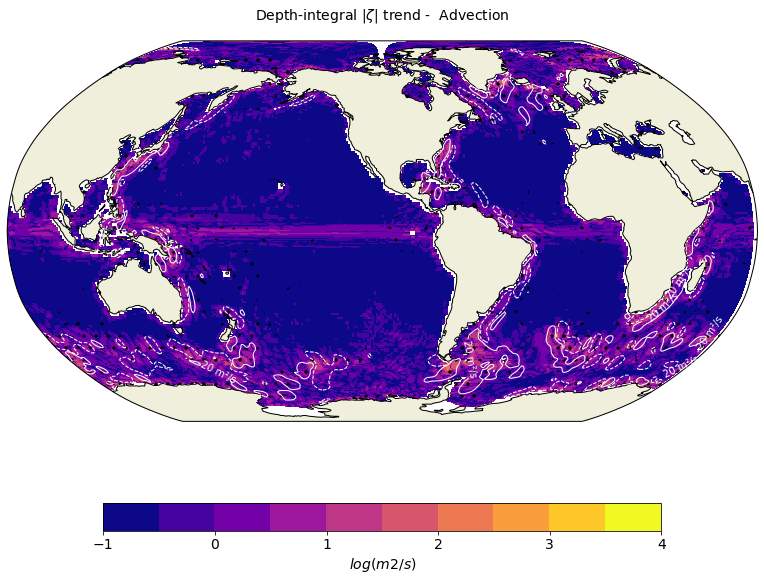

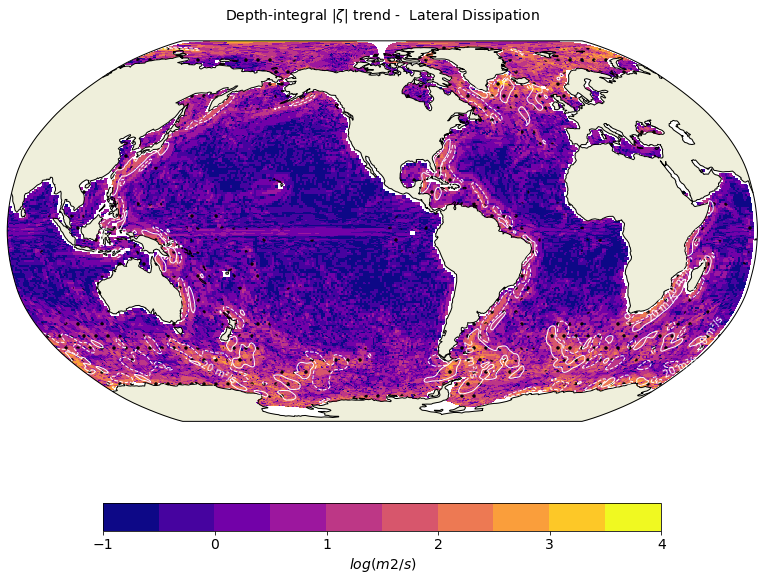

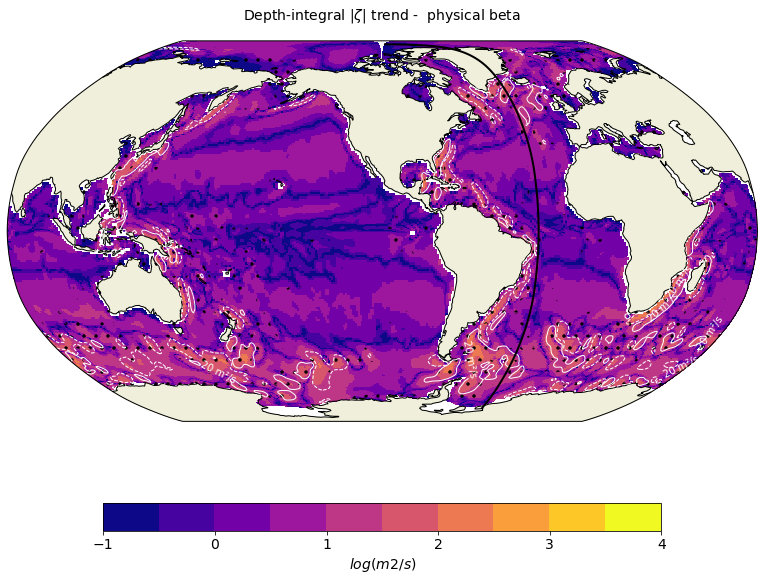

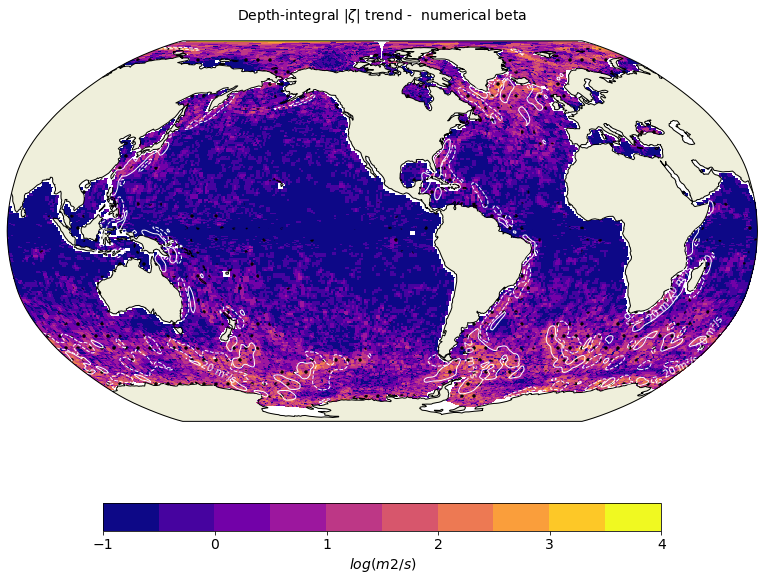

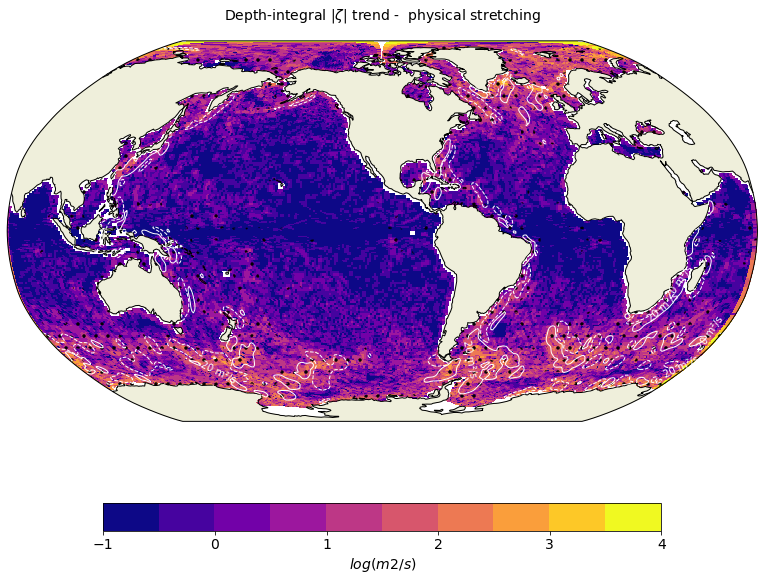

...

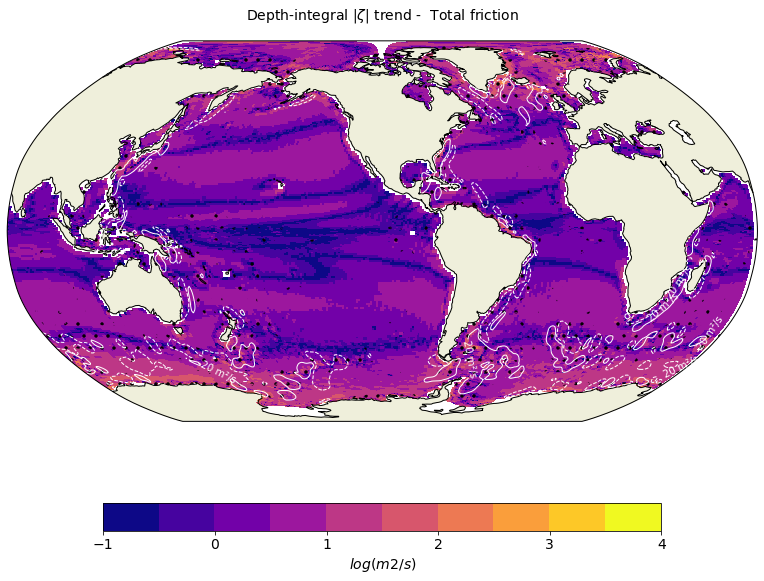

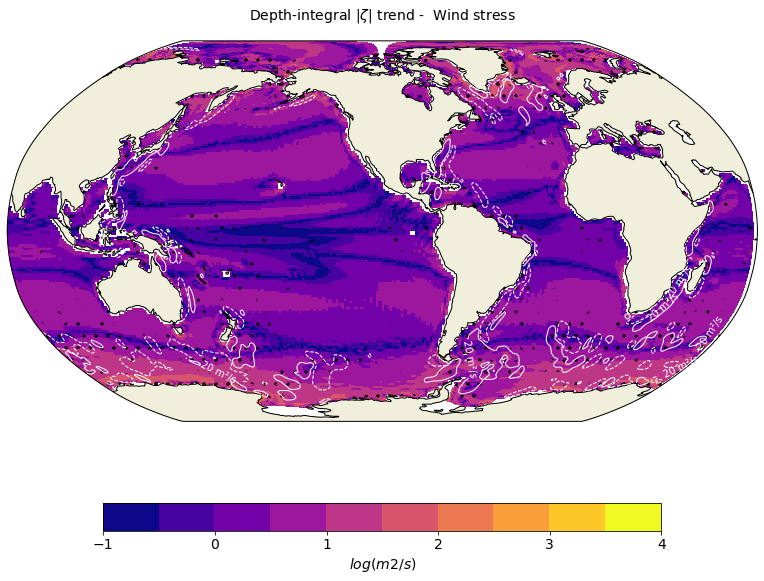

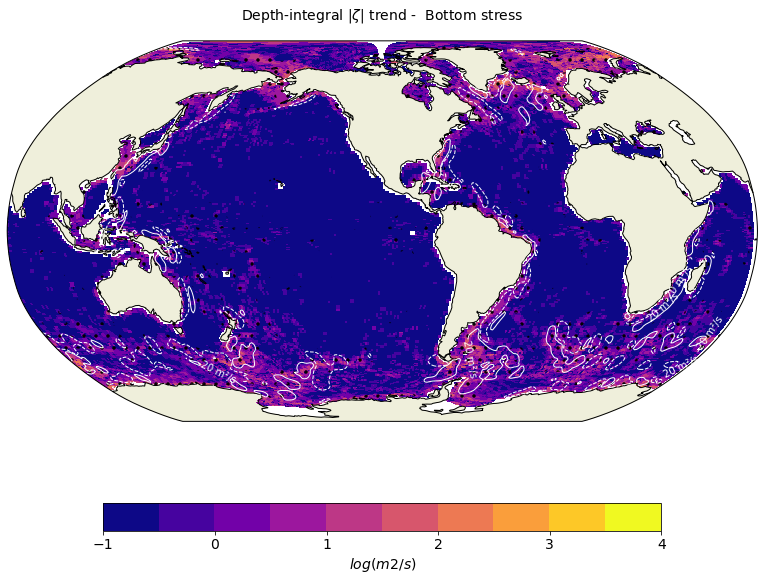

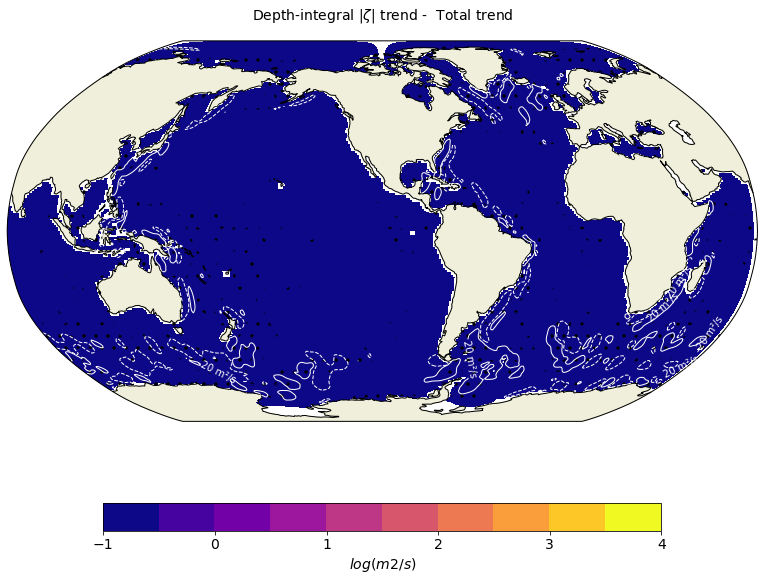

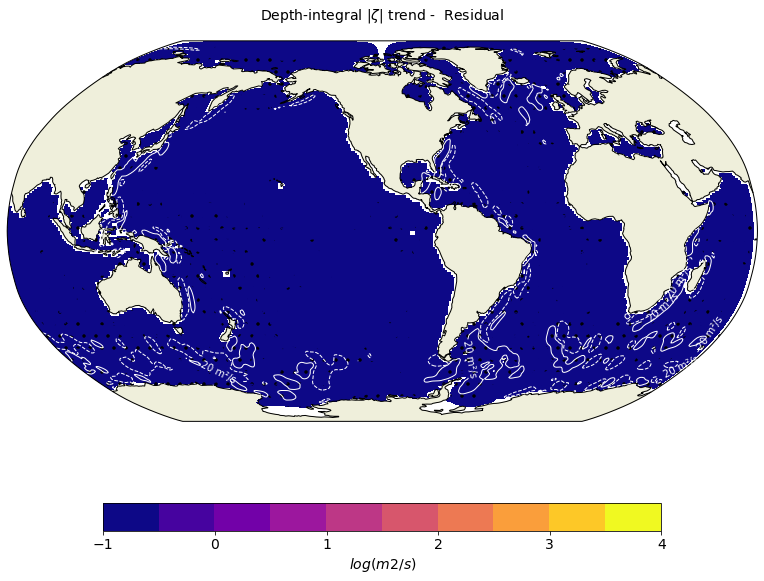

In [7]:
# Figure properties:
levs=np.linspace(-1,4,11)
unit='$log(m2/s)$'
title='Depth-integral |$\zeta$| trend - '
file='Z_budget_int_'
levs_v_xy=[-20, 20]

# Advection
ax,cbar=global_map(x,y,log10(abs(ztrd_int.ztrdkeg+ztrd_int.ztrdrvo+ztrd_int.ztrdzad)/b),
           levs,unit,title+' Advection',colorbar,file+'adv',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'adv','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'adv')

# Lateral dissipation
ax,cbar=global_map(x,y,log10(abs(ztrd_int.ztrdldf)/b),
           levs,unit,title+' Lateral Dissipation',colorbar,file+'ldf',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'ldf','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'ldf')

# Coriolis and its decomposition
ax,cbar=global_map(x,y,log10(abs(ztrd2_int.ztrd_betaphys)/b),
           levs,unit,title+' physical beta',colorbar,file+'beta_phys',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'beta_phys','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'beta_phys')
atl_line(ax,x_Atl.isel(lev=0),y_Atl.isel(lev=0),file+'beta_phys')

ax,cbar=global_map(x,y,log10(abs(ztrd2_int.ztrd_betanum)/b),
           levs,unit,title+' numerical beta',colorbar,file+'beta_num',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'beta_num','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'beta_num')

ax,cbar=global_map(x,y,log10(abs(ztrd2_int.ztrd_stretchphys)/b),
           levs,unit,title+' physical stretching',colorbar,file+'stretch_phys',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'stretch_phys','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'stretch_phys')

ax,cbar=global_map(x,y,log10(abs(ztrd2_int.ztrd_stretchnum)/b),
           levs,unit,title+' numerical stretching',colorbar,file+'stretch_num',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'stretch_num','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'stretch_num')

ax,cbar=global_map(x,y,log10(abs(ztrd2_int.ztrd_betanum+ztrd2_int.ztrd_stretchnum)/b),
           levs,unit,title+' numerical',colorbar,file+'num',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'num','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'num')

# Pressure force
ax,cbar=global_map(x,y,log10(abs(ztrd_int.ztrdhpg)/b),
           levs,unit,title+' Pressure force',colorbar,file+'pg',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'pg','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'pg')

# Barotropic trend (wind, bottom stress plus barotropic correction)
ax,cbar=global_map(x,y,log10(abs(ztrd_int.ztrdspg)/b),
           levs,unit,title+' Barotropic friction',colorbar,file+'bt',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'bt','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'bt')

# Baroclinic vertical friction
ax,cbar=global_map(x,y,log10(abs(ztrd_int.ztrdzdf)/b),
           levs,unit,title+' Baroclinic friction',colorbar,file+'zdfbc',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'zdfbc','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'zdfbc')

# Total vertical friction
ax,cbar=global_map(x,y,log10(abs(ztrd_int.ztrdspg+ztrd_int.ztrdzdf)/b),
           levs,unit,title+' Total friction',colorbar,file+'zdf',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'zdf','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'zdf')

# Surface wind stress
ax,cbar=global_map(x,y,log10(abs(ztrd_int.ztrdtau/rho0)/b),
           levs,unit,title+' Wind stress',colorbar,file+'tau',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'tau','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'tau')

# Bottom friction
ax,cbar=global_map(x,y,log10(abs(ztrd_int.ztrdspg+ztrd_int.ztrdzdf-ztrd_int.ztrdtau/rho0)/b),
           levs,unit,title+' Bottom stress',colorbar,file+'taub',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'taub','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'taub')

# Total trend
ax,cbar=global_map(x,y,log10(abs(ztrd_int.ztrdtot)/b),
           levs,unit,title+' Total trend',colorbar,file+'tot',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'tot','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'tot')

# Residual (Asselin time filter plus error)
ax,cbar=global_map(x,y,log10(abs(ztrd_int.ztrdtot-(ztrd_int.ztrdkeg+ztrd_int.ztrdrvo+ztrd_int.ztrdzad+ztrd_int.ztrdldf+ztrd_int.ztrdpvo+ztrd_int.ztrdhpg+ztrd_int.ztrdspg+ztrd_int.ztrdzdf))/b),
           levs,unit,title+' Residual',colorbar,file+'res',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'res','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'res')

## Barotropic vorticity equation = vorticity of the depth-integral momentum equation

/usr/lib/python3/dist-packages/xarray/core/computation.py:604: RuntimeWarning: divide by zero encountered in log
  result_data = func(*input_data)


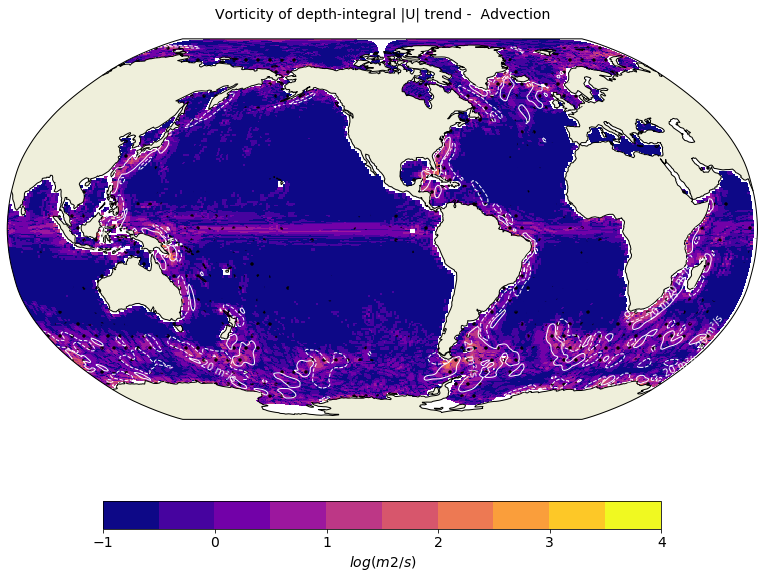

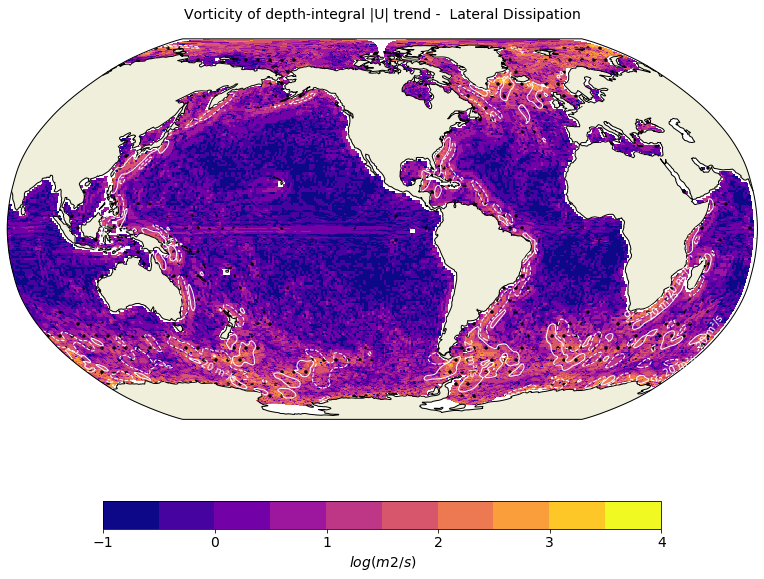

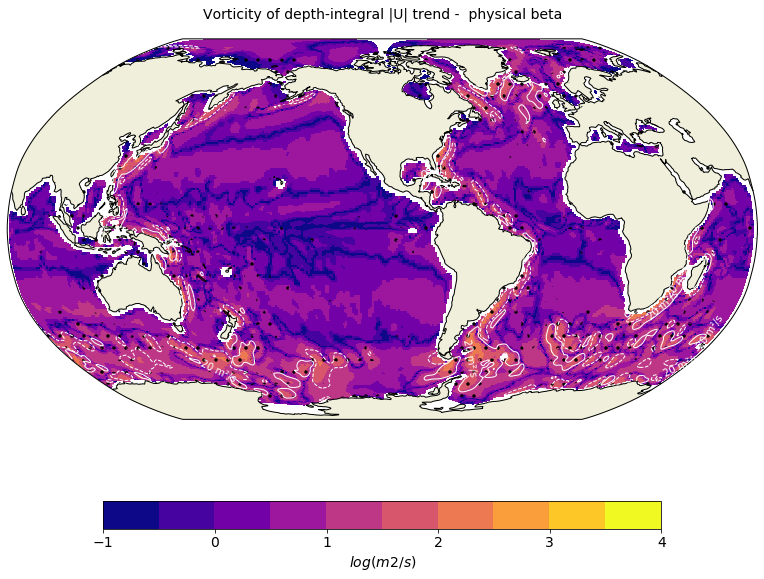

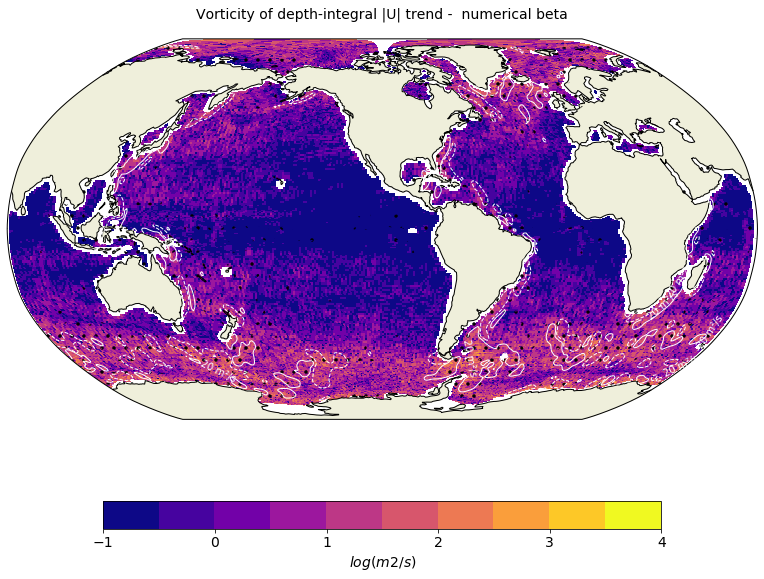

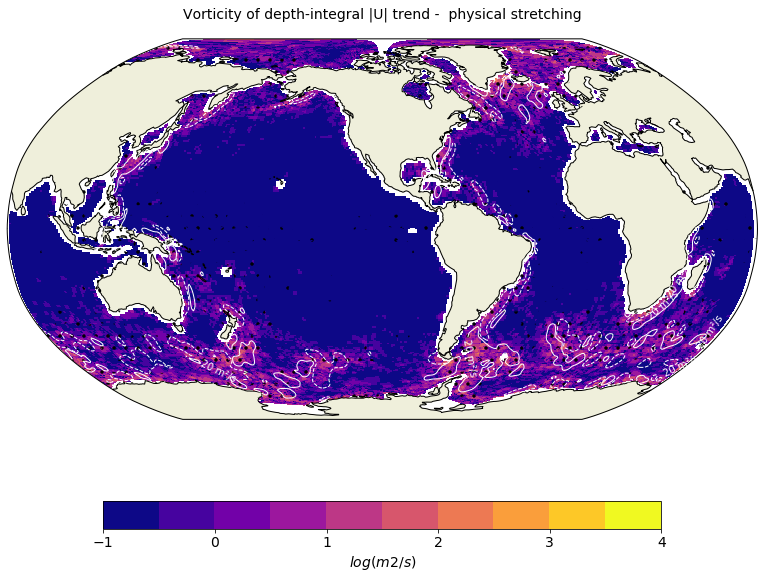

...

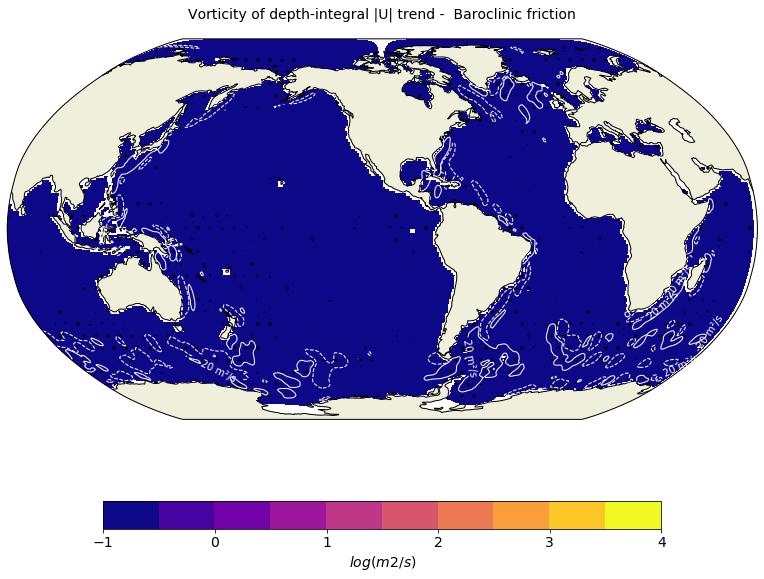

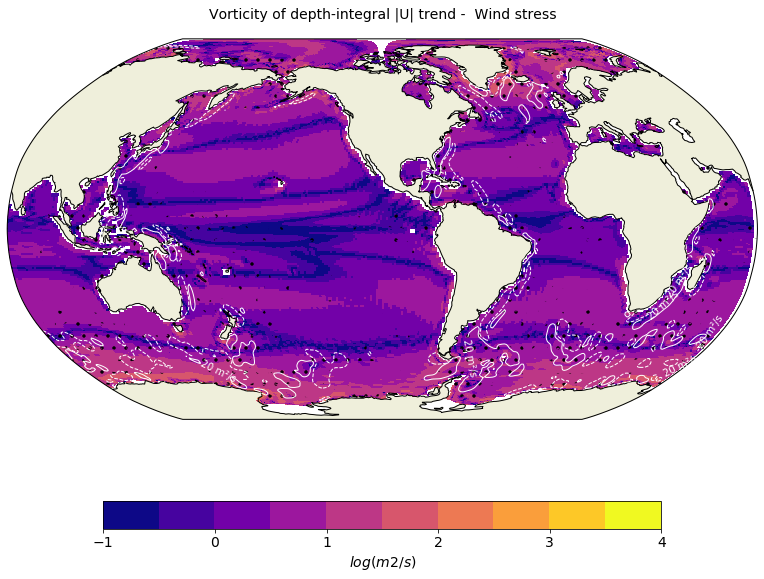

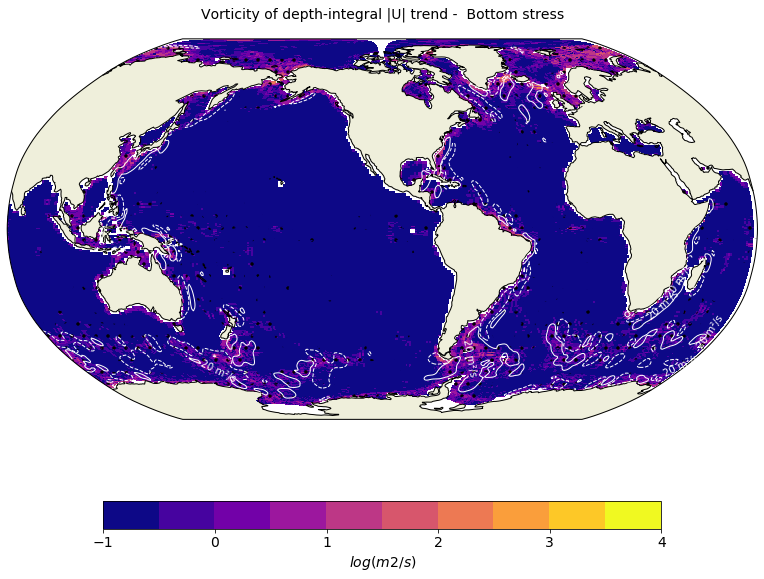

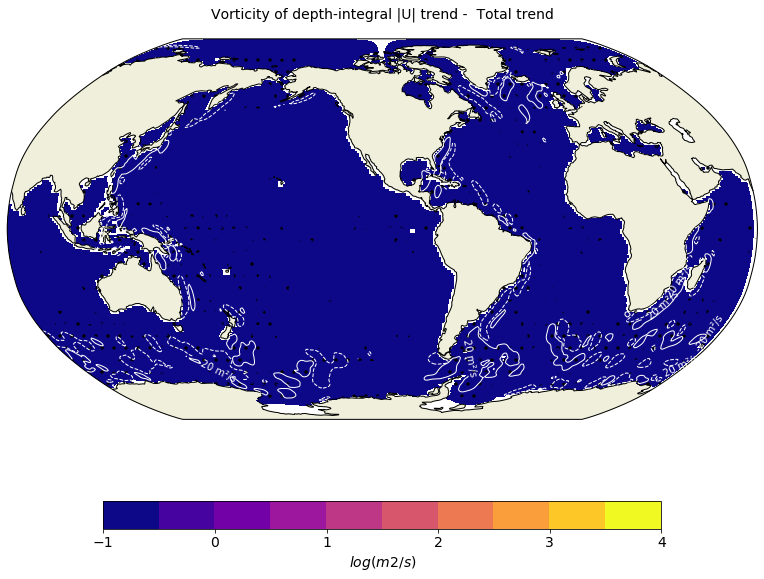

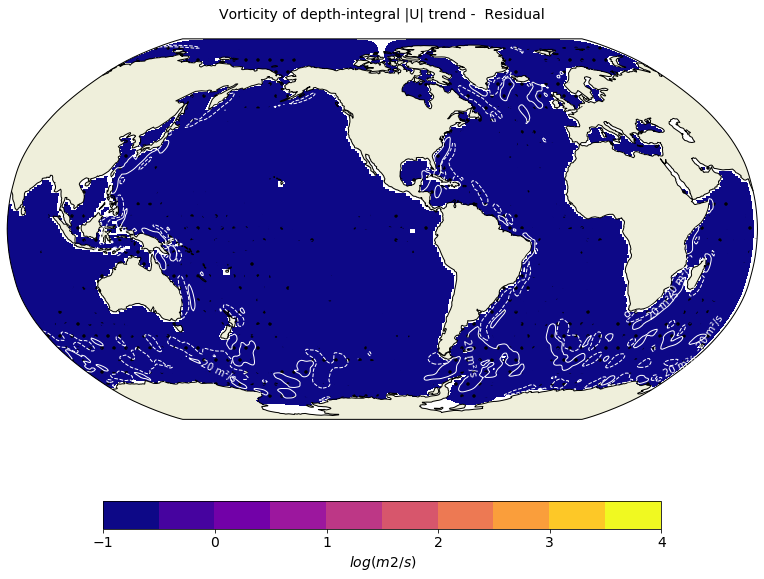

In [8]:
# Figure properties:
levs=np.linspace(-1,4,11)
unit='$log(m2/s)$'
levs_v_xy=[-20, 20]
title='Vorticity of depth-integral |U| trend - '
file='curl_U_budget_int_'

# Advection
ax,cbar=global_map(x,y,log10(abs(curl_utrd_int.ztrdkeg+curl_utrd_int.ztrdrvo+curl_utrd_int.ztrdzad)/b),
           levs,unit,title+' Advection',colorbar,file+'adv',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'adv','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'adv')

# Lateral dissipation
ax,cbar=global_map(x,y,log10(abs(curl_utrd_int.ztrdldf)/b),
           levs,unit,title+' Lateral Dissipation',colorbar,file+'ldf',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'ldf','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'ldf')

# Coriolis and its decomposition
ax,cbar=global_map(x,y,log10(abs(curl_utrd2_int.ztrd_betaphys)/b),
           levs,unit,title+' physical beta',colorbar,file+'beta_phys',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'beta_phys','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'beta_phys')

ax,cbar=global_map(x,y,log10(abs(curl_utrd2_int.ztrd_betanum)/b),
           levs,unit,title+' numerical beta',colorbar,file+'beta_num',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'beta_num','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'beta_num')

ax,cbar=global_map(x,y,log10(abs(curl_utrd2_int.ztrd_stretchphys)/b),
           levs,unit,title+' physical stretching',colorbar,file+'stretch_phys',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'stretch_phys','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'stretch_phys')

ax,cbar=global_map(x,y,log10(abs(curl_utrd2_int.ztrd_stretchnum)/b),
           levs,unit,title+' numerical stretching',colorbar,file+'stretch_num',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'stretch_num','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'stretch_num')

ax,cbar=global_map(x,y,log10(abs(curl_utrd2_int.ztrd_crossnum)/b),
           levs,unit,title+' numerical crossed',colorbar,file+'cross_num',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'cross_num','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'cross_num')

ax,cbar=global_map(x,y,log10(abs(curl_utrd2_int.ztrd_betanum+curl_utrd2_int.ztrd_stretchnum+curl_utrd2_int.ztrd_crossnum)/b),
           levs,unit,title+' numerical',colorbar,file+'num',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'num','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'num')

# Pressure force
ax,cbar=global_map(x,y,log10(abs(curl_utrd_int.ztrdhpg)/b),
           levs,unit,title+' Pressure force',colorbar,file+'pg',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'pg','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'pg')

# Barotropic trend (wind, bottom stress plus barotropic correction)
ax,cbar=global_map(x,y,log10(abs(curl_utrd_int.ztrdspg)/b),
           levs,unit,title+' Barotropic friction',colorbar,file+'bt',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'bt','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'bt')

# Baroclinic vertical friction
ax,cbar=global_map(x,y,log10(abs(curl_utrd_int.ztrdzdf)/b),
           levs,unit,title+' Baroclinic friction',colorbar,file+'zdf',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'zdf','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'zdf')

# Surface wind stress
ax,cbar=global_map(x,y,log10(abs(curl_utrd_int.ztrdtau/rho0)/b),
           levs,unit,title+' Wind stress',colorbar,file+'tau',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'tau','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'tau')

# Bottom friction
ax,cbar=global_map(x,y,log10(abs(curl_utrd_int.ztrdspg-curl_utrd_int.ztrdtau/rho0)/b),
           levs,unit,title+' Bottom stress',colorbar,file+'taub',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'taub','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'taub')

# Total trend
ax,cbar=global_map(x,y,log10(abs(curl_utrd_int.ztrdtot)/b),
           levs,unit,title+' Total trend',colorbar,file+'tot',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'tot','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'tot')

# Residual (Asselin time filter plus error)
ax,cbar=global_map(x,y,log10(abs(curl_utrd_int.ztrdtot-(curl_utrd_int.ztrdkeg+curl_utrd_int.ztrdrvo+curl_utrd_int.ztrdzad+curl_utrd_int.ztrdldf+curl_utrd_int.ztrdpvo+curl_utrd_int.ztrdhpg+curl_utrd_int.ztrdspg+curl_utrd_int.ztrdzdf))/b),
           levs,unit,title+' Residual',colorbar,file+'res',projection)
global_contour(ax,x,y,v_int,levs_v_xy,'%1.0f m²/s',file+'res','w')
global_hatching(ax,x,y,u_bot,levs_ubot,file+'res')

## Vorticity of the depth-average momentum equation

/usr/lib/python3/dist-packages/xarray/core/computation.py:604: RuntimeWarning: divide by zero encountered in log
  result_data = func(*input_data)
/home/waldmanr/Bureau/Model/VoBiN/plot/plot_methods.py:65: RuntimeWarning: invalid value encountered in less
  u_rot, v_rot = proj.transform_vectors(src_crs,x,y,u/np.cos(y/180*np.pi),v)
/home/waldmanr/Bureau/Model/VoBiN/plot/plot_methods.py:65: RuntimeWarning: invalid value encountered in greater
  u_rot, v_rot = proj.transform_vectors(src_crs,x,y,u/np.cos(y/180*np.pi),v)
/home/waldmanr/Bureau/Model/VoBiN/plot/plot_methods.py:66: RuntimeWarning: invalid value encountered in true_divide
  renorm = np.sqrt((u**2 + v**2) / (u_rot**2 + v_rot**2))
/usr/lib/python3/dist-packages/cartopy/mpl/geoaxes.py:1752: RuntimeWarning: invalid value encountered in less
  u, v = self.projection.transform_vectors(t, x, y, u, v)
/usr/lib/python3/dist-packages/cartopy/mpl/geoaxes.py:1752: RuntimeWarning: invalid value encountered in greater
  u, v = self.projectio

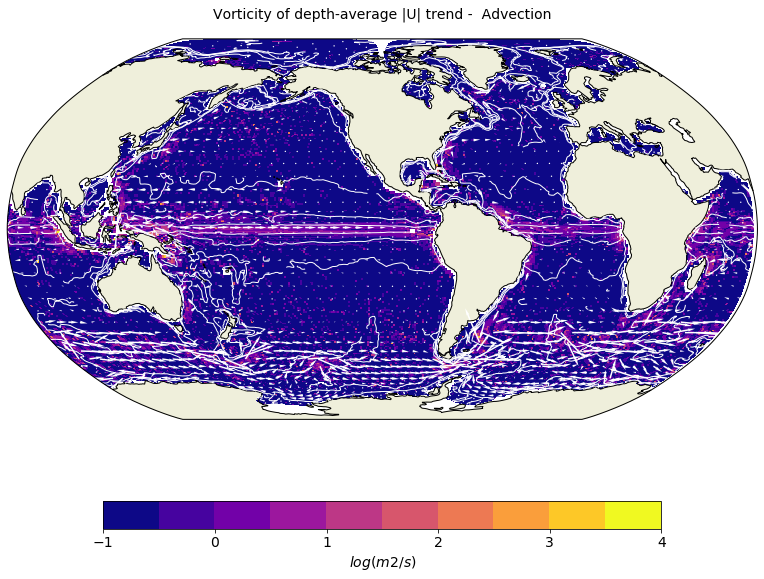

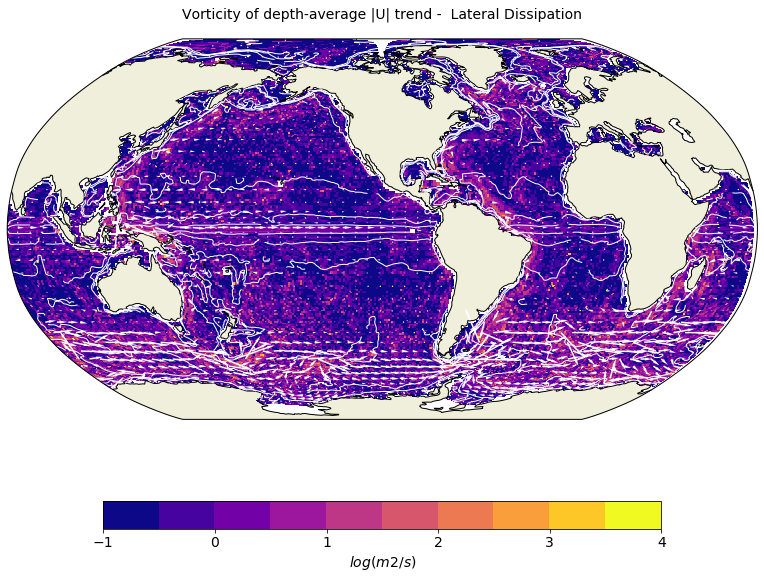

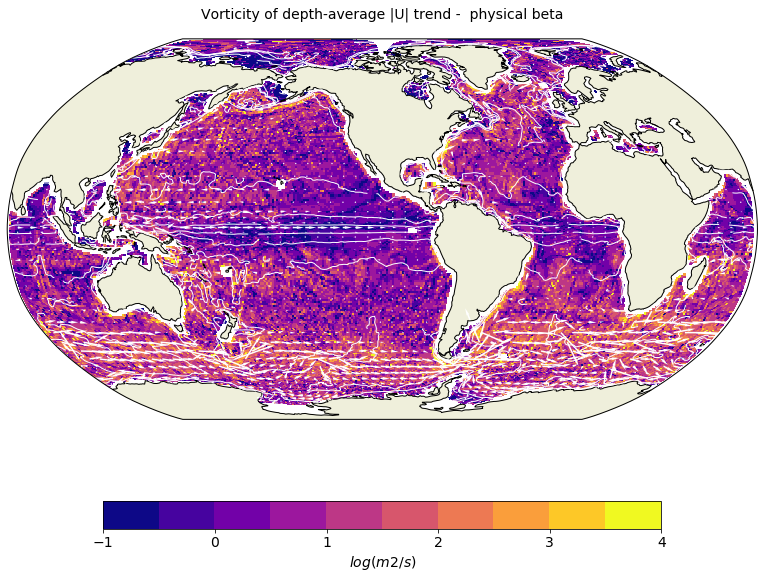

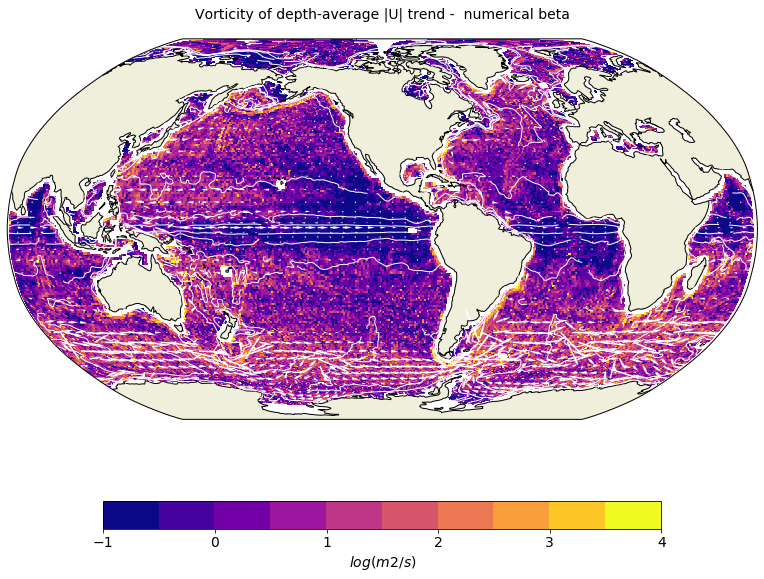

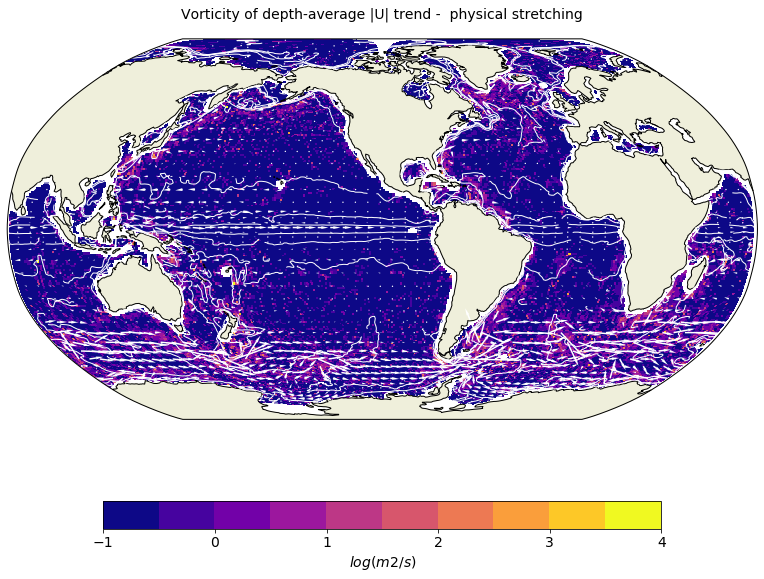

...

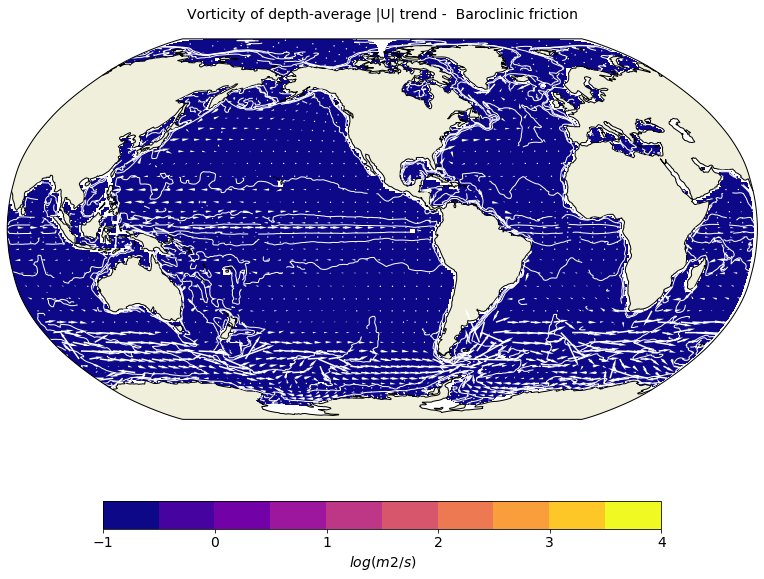

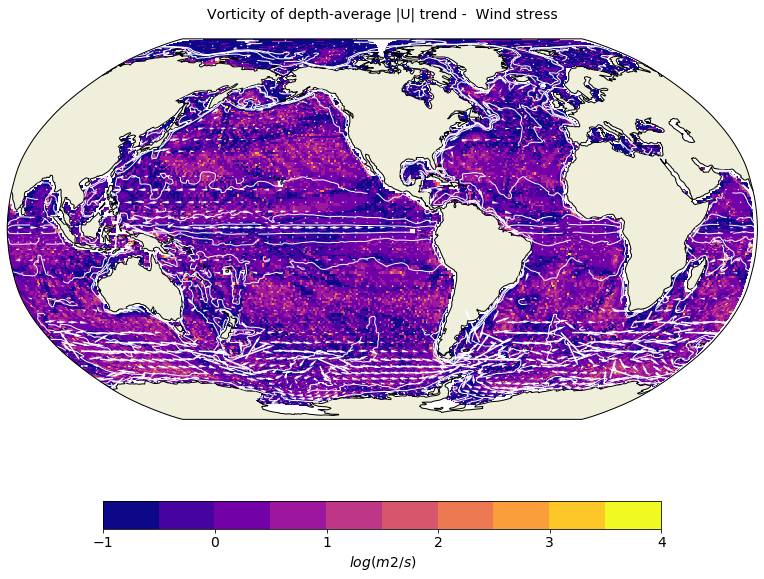

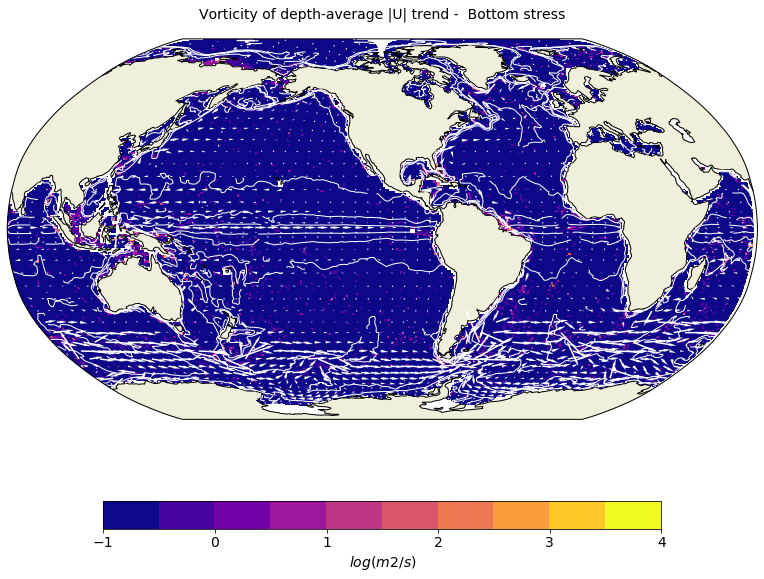

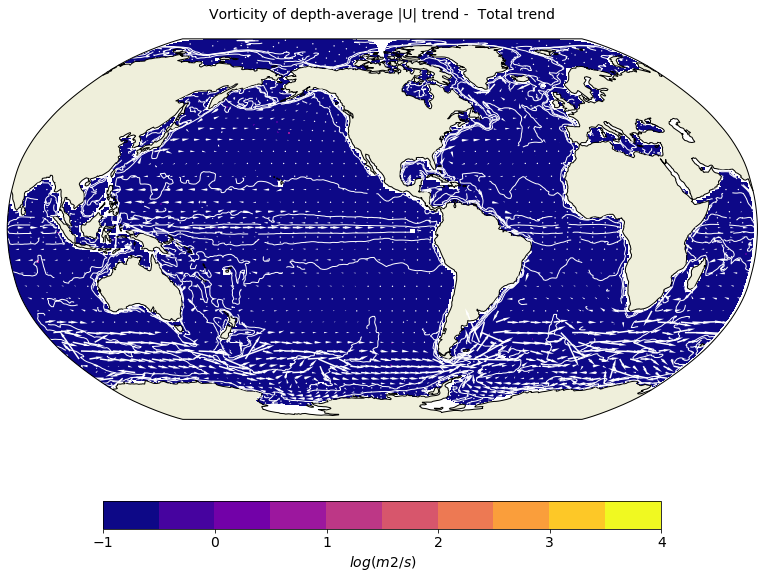

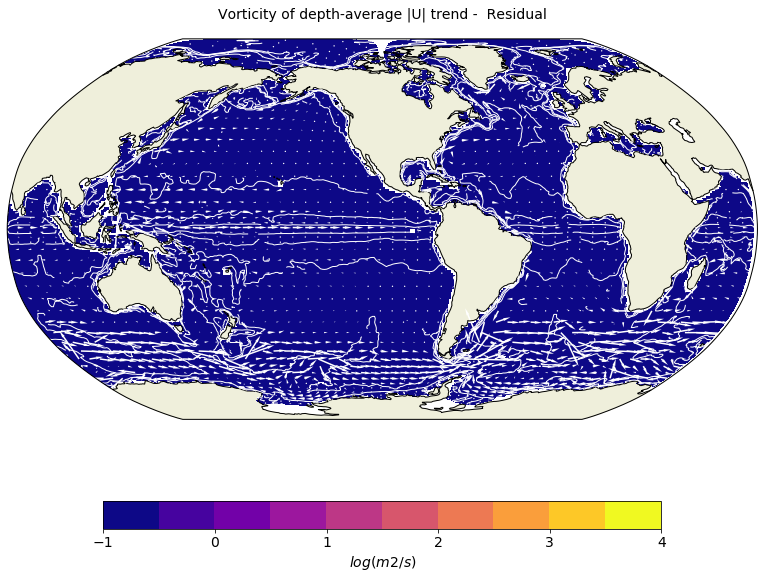

In [9]:
# Figure properties:
title='Vorticity of depth-average |U| trend - '
file='curl_U_budget_av_'
fh=meshmask.div_fh
levs_fh=np.linspace(5,9,9)
fh_log=-log10(np.abs(meshmask.f_u/meshmask.bathy_u))

# Advection
ax,cbar=global_map(x,y,log10(abs(curl_utrd_av.ztrdkeg+curl_utrd_av.ztrdrvo+curl_utrd_av.ztrdzad)/fh),
           levs,unit,title+' Advection',colorbar,file+'adv',projection)
global_quiver(ax,x,y,u_int,v_int,file+'adv','w')
global_contour(ax,x,y,fh_log,levs_fh,'',file+'adv','w')

# Lateral dissipation
ax,cbar=global_map(x,y,log10(abs(curl_utrd_av.ztrdldf)/fh),
           levs,unit,title+' Lateral Dissipation',colorbar,file+'ldf',projection)
global_quiver(ax,x,y,u_int,v_int,file+'ldf','w')
global_contour(ax,x,y,fh_log,levs_fh,'',file+'ldf','w')

# Coriolis and its decomposition
ax,cbar=global_map(x,y,log10(abs(curl_utrd2_av.ztrd_betaphys)/fh),
           levs,unit,title+' physical beta',colorbar,file+'beta_phys',projection)
global_quiver(ax,x,y,u_int,v_int,file+'beta_phys','w')
global_contour(ax,x,y,fh_log,levs_fh,'',file+'beta_phys','w')

ax,cbar=global_map(x,y,log10(abs(curl_utrd2_av.ztrd_betanum)/fh),
           levs,unit,title+' numerical beta',colorbar,file+'beta_num',projection)
global_quiver(ax,x,y,u_int,v_int,file+'beta_num','w')
global_contour(ax,x,y,fh_log,levs_fh,'',file+'beta_num','w')

ax,cbar=global_map(x,y,log10(abs(curl_utrd2_av.ztrd_stretchphys)/fh),
           levs,unit,title+' physical stretching',colorbar,file+'stretch_phys',projection)
global_quiver(ax,x,y,u_int,v_int,file+'stretch_phys','w')
global_contour(ax,x,y,fh_log,levs_fh,'',file+'stretch_phys','w')

ax,cbar=global_map(x,y,log10(abs(curl_utrd2_av.ztrd_stretchnum)/fh),
           levs,unit,title+' numerical stretching',colorbar,file+'stretch_num',projection)
global_quiver(ax,x,y,u_int,v_int,file+'stretch_num','w')
global_contour(ax,x,y,fh_log,levs_fh,'',file+'stretch_num','w')

ax,cbar=global_map(x,y,log10(abs(curl_utrd2_av.ztrd_crossnum)/fh),
           levs,unit,title+' numerical crossed',colorbar,file+'cross_num',projection)
global_quiver(ax,x,y,u_int,v_int,file+'cross_num','w')
global_contour(ax,x,y,fh_log,levs_fh,'',file+'cross_num','w')

ax,cbar=global_map(x,y,log10(abs(curl_utrd2_av.ztrd_betanum+curl_utrd2_av.ztrd_stretchnum+curl_utrd2_av.ztrd_crossnum)/fh),
           levs,unit,title+' numerical',colorbar,file+'num',projection)
global_quiver(ax,x,y,u_int,v_int,file+'num','w')
global_contour(ax,x,y,fh_log,levs_fh,'',file+'num','w')

# Pressure force
ax,cbar=global_map(x,y,log10(abs(curl_utrd_av.ztrdhpg)/fh),
           levs,unit,title+' Pressure force',colorbar,file+'pg',projection)
global_quiver(ax,x,y,u_int,v_int,file+'pg','w')
global_contour(ax,x,y,fh_log,levs_fh,'',file+'pg','w')

# Barotropic trend (wind, bottom stress plus barotropic correction)
ax,cbar=global_map(x,y,log10(abs(curl_utrd_av.ztrdspg)/fh),
           levs,unit,title+' Barotropic friction',colorbar,file+'bt',projection)
global_quiver(ax,x,y,u_int,v_int,file+'bt','w')
global_contour(ax,x,y,fh_log,levs_fh,'',file+'bt','w')

# Baroclinic vertical friction
ax,cbar=global_map(x,y,log10(abs(curl_utrd_av.ztrdzdf)/fh),
           levs,unit,title+' Baroclinic friction',colorbar,file+'zdf',projection)
global_quiver(ax,x,y,u_int,v_int,file+'zdf','w')
global_contour(ax,x,y,fh_log,levs_fh,'',file+'zdf','w')

# Surface wind stress
ax,cbar=global_map(x,y,log10(abs(curl_utrd_av.ztrdtau/rho0)/fh),
           levs,unit,title+' Wind stress',colorbar,file+'tau',projection)
global_quiver(ax,x,y,u_int,v_int,file+'tau','w')
global_contour(ax,x,y,fh_log,levs_fh,'',file+'tau','w')

# Bottom friction
ax,cbar=global_map(x,y,log10(abs(curl_utrd_av.ztrdspg-curl_utrd_av.ztrdtau/rho0)/fh),
           levs,unit,title+' Bottom stress',colorbar,file+'taub',projection)
global_quiver(ax,x,y,u_int,v_int,file+'taub','w')
global_contour(ax,x,y,fh_log,levs_fh,'',file+'taub','w')

# Total trend
ax,cbar=global_map(x,y,log10(abs(curl_utrd_av.ztrdtot)/fh),
           levs,unit,title+' Total trend',colorbar,file+'tot',projection)
global_quiver(ax,x,y,u_int,v_int,file+'tot','w')
global_contour(ax,x,y,fh_log,levs_fh,'',file+'tot','w')

# Residual (Asselin time filter plus error)
ax,cbar=global_map(x,y,log10(abs(curl_utrd_av.ztrdtot-(curl_utrd_av.ztrdkeg+curl_utrd_av.ztrdrvo+curl_utrd_av.ztrdzad+curl_utrd_av.ztrdldf+curl_utrd_av.ztrdpvo+curl_utrd_av.ztrdhpg+curl_utrd_av.ztrdspg+curl_utrd_av.ztrdzdf))/fh),
           levs,unit,title+' Residual',colorbar,file+'res',projection)
global_quiver(ax,x,y,u_int,v_int,file+'res','w')
global_contour(ax,x,y,fh_log,levs_fh,'',file+'res','w')

## Vorticity of the transport momentum equation = depth-integral momentum equation over f

/usr/lib/python3/dist-packages/xarray/core/computation.py:604: RuntimeWarning: divide by zero encountered in log
  result_data = func(*input_data)


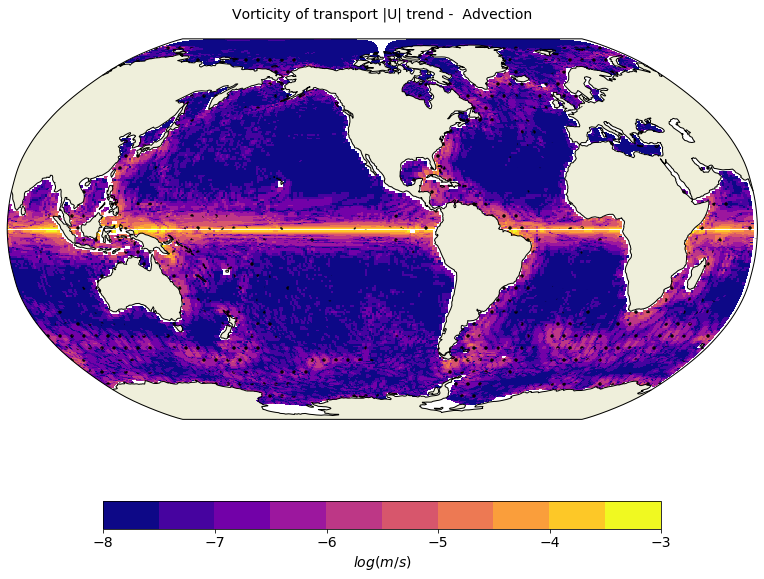

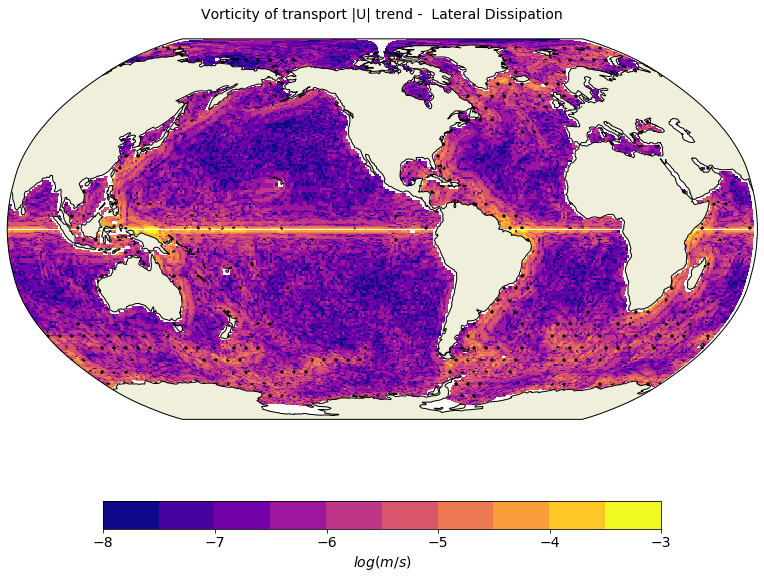

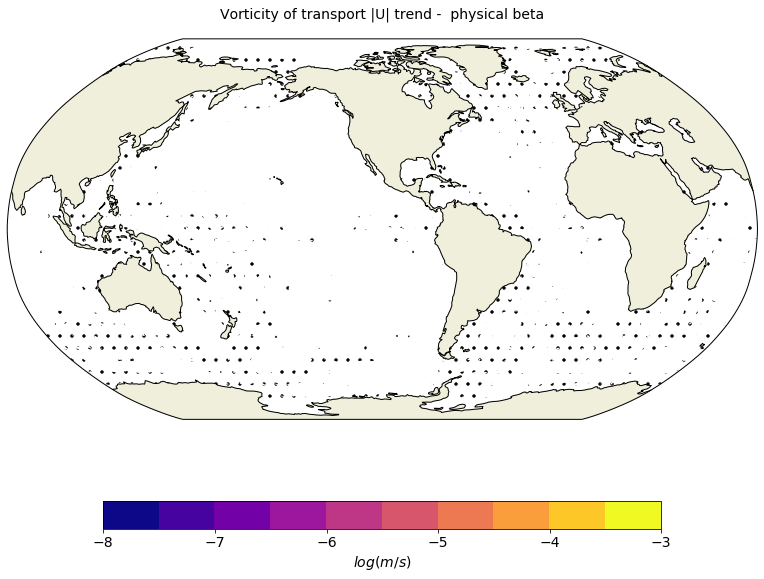

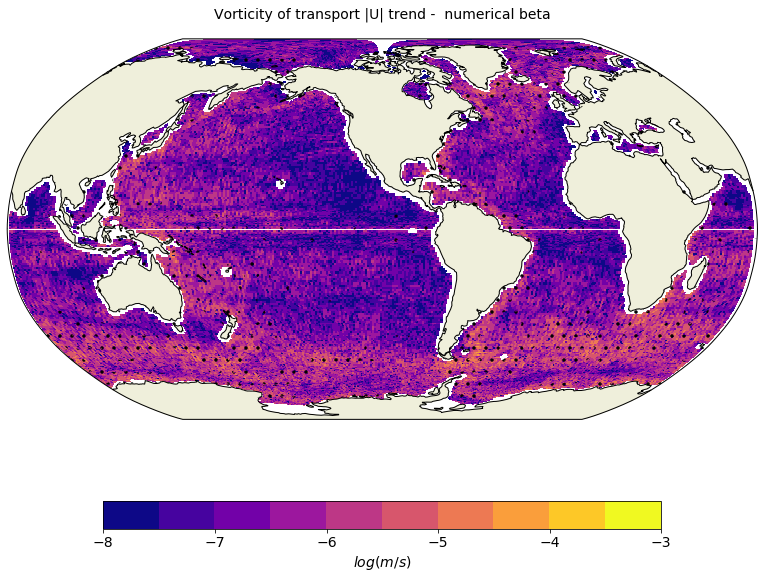

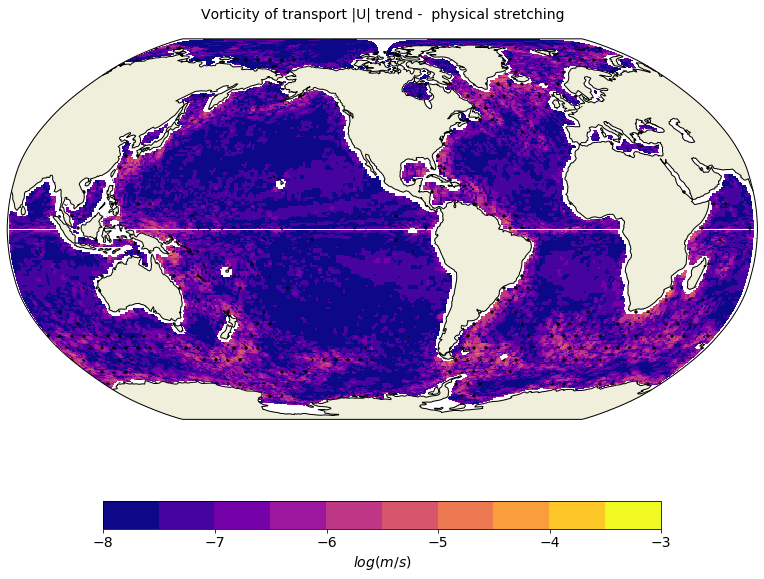

...

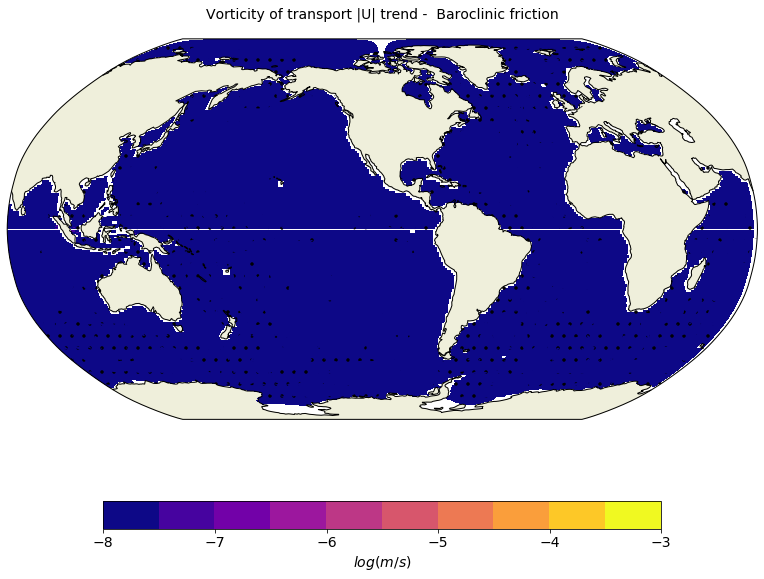

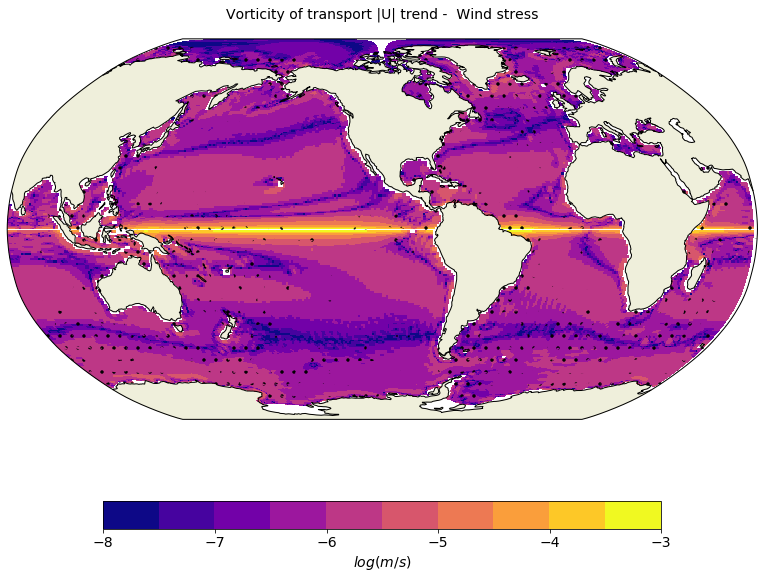

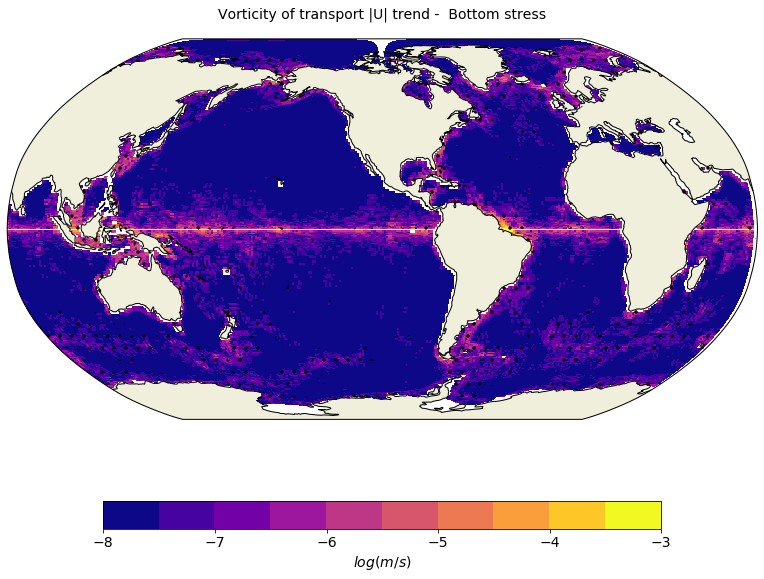

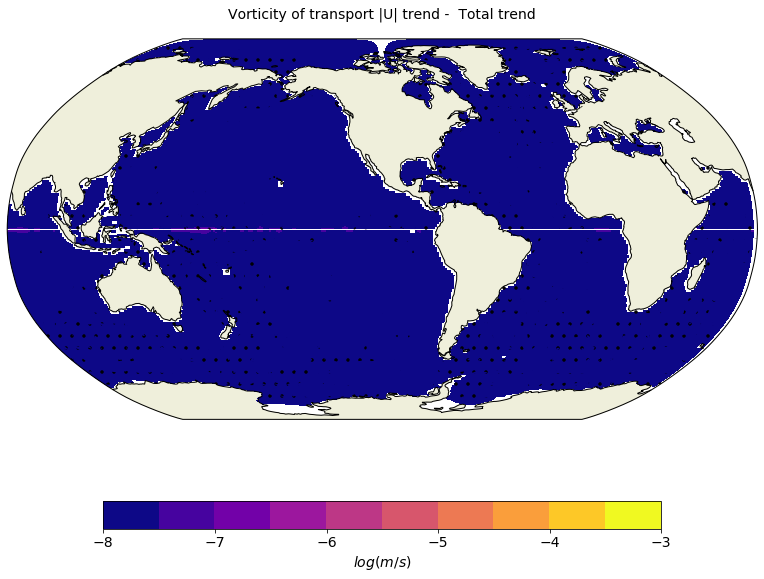

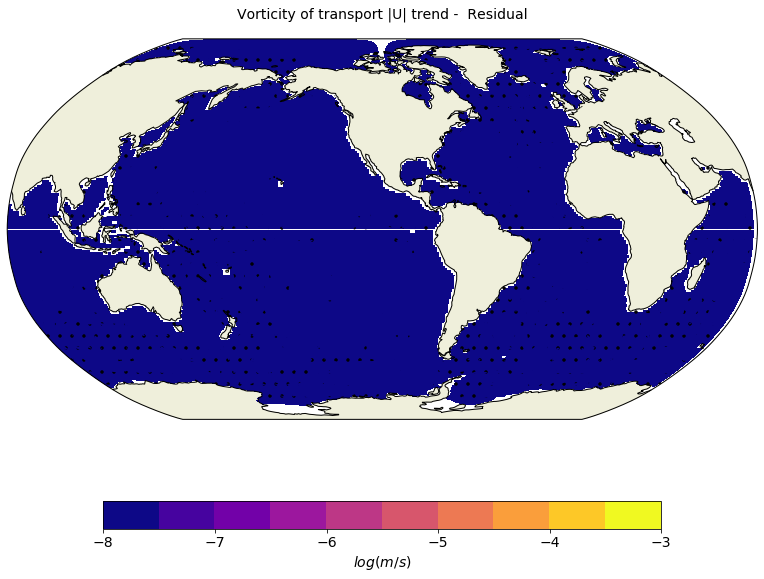

In [10]:
# Figure properties:
levs=np.linspace(-8,-3,11)
unit='$log(m/s)$'
title='Vorticity of transport |U| trend - '
file='curl_U_budget_transp_'

# Advection
ax,cbar=global_map(x,y,log10(abs(curl_utrd_transp.ztrdkeg+curl_utrd_transp.ztrdrvo+curl_utrd_transp.ztrdzad)),
           levs,unit,title+' Advection',colorbar,file+'adv',projection)
global_hatching(ax,x,y,u_bot,levs_ubot,file+'adv')

# Lateral dissipation
ax,cbar=global_map(x,y,log10(abs(curl_utrd_transp.ztrdldf)),
           levs,unit,title+' Lateral Dissipation',colorbar,file+'ldf',projection)
global_hatching(ax,x,y,u_bot,levs_ubot,file+'ldf')

# Coriolis and its decomposition
ax,cbar=global_map(x,y,log10(abs(curl_utrd2_transp.ztrd_betaphys)),
           levs,unit,title+' physical beta',colorbar,file+'beta_phys',projection)
global_hatching(ax,x,y,u_bot,levs_ubot,file+'beta_phys')

ax,cbar=global_map(x,y,log10(abs(curl_utrd2_transp.ztrd_betanum)),
           levs,unit,title+' numerical beta',colorbar,file+'beta_num',projection)
global_hatching(ax,x,y,u_bot,levs_ubot,file+'beta_num')

ax,cbar=global_map(x,y,log10(abs(curl_utrd2_transp.ztrd_stretchphys)),
           levs,unit,title+' physical stretching',colorbar,file+'stretch_phys',projection)
global_hatching(ax,x,y,u_bot,levs_ubot,file+'stretch_phys')

ax,cbar=global_map(x,y,log10(abs(curl_utrd2_transp.ztrd_stretchnum)),
           levs,unit,title+' numerical stretching',colorbar,file+'stretch_num',projection)
global_hatching(ax,x,y,u_bot,levs_ubot,file+'stretch_num')

ax,cbar=global_map(x,y,log10(abs(curl_utrd2_transp.ztrd_crossnum)),
           levs,unit,title+' numerical crossed',colorbar,file+'cross_num',projection)
global_hatching(ax,x,y,u_bot,levs_ubot,file+'cross_num')

ax,cbar=global_map(x,y,log10(abs(curl_utrd2_transp.ztrd_betanum+curl_utrd2_transp.ztrd_stretchnum+curl_utrd2_transp.ztrd_crossnum)),
           levs,unit,title+' numerical',colorbar,file+'num',projection)
global_hatching(ax,x,y,u_bot,levs_ubot,file+'num')

# Pressure force
ax,cbar=global_map(x,y,log10(abs(curl_utrd_transp.ztrdhpg)),
           levs,unit,title+' Pressure force',colorbar,file+'pg',projection)
global_hatching(ax,x,y,u_bot,levs_ubot,file+'pg')

# Barotropic trend (wind, bottom stress plus barotropic correction)
ax,cbar=global_map(x,y,log10(abs(curl_utrd_transp.ztrdspg)),
           levs,unit,title+' Barotropic friction',colorbar,file+'bt',projection)
global_hatching(ax,x,y,u_bot,levs_ubot,file+'bt')

# Baroclinic vertical friction
ax,cbar=global_map(x,y,log10(abs(curl_utrd_transp.ztrdzdf)),
           levs,unit,title+' Baroclinic friction',colorbar,file+'zdf',projection)
global_hatching(ax,x,y,u_bot,levs_ubot,file+'zdf')

# Surface wind stress
ax,cbar=global_map(x,y,log10(abs(curl_utrd_transp.ztrdtau/rho0)),
           levs,unit,title+' Wind stress',colorbar,file+'tau',projection)
global_hatching(ax,x,y,u_bot,levs_ubot,file+'tau')

# Bottom friction
ax,cbar=global_map(x,y,log10(abs(curl_utrd_transp.ztrdspg-curl_utrd_transp.ztrdtau/rho0)),
           levs,unit,title+' Bottom stress',colorbar,file+'taub',projection)
global_hatching(ax,x,y,u_bot,levs_ubot,file+'taub')

# Total trend
ax,cbar=global_map(x,y,log10(abs(curl_utrd_transp.ztrdtot)),
           levs,unit,title+' Total trend',colorbar,file+'tot',projection)
global_hatching(ax,x,y,u_bot,levs_ubot,file+'tot')

# Residual (Asselin time filter plus error)
ax,cbar=global_map(x,y,log10(abs(curl_utrd_transp.ztrdtot-(curl_utrd_transp.ztrdkeg+curl_utrd_transp.ztrdrvo+curl_utrd_transp.ztrdzad+curl_utrd_transp.ztrdldf+curl_utrd_transp.ztrdpvo+curl_utrd_transp.ztrdhpg+curl_utrd_transp.ztrdspg+curl_utrd_transp.ztrdzdf))),
           levs,unit,title+' Residual',colorbar,file+'res',projection)
global_hatching(ax,x,y,u_bot,levs_ubot,file+'res')

# 3. Main dynamical balances

In [11]:
# Common figure properties:
levs6=np.linspace(-0.5,5.5,7)
levs5=np.linspace(-0.5,4.5,6)
unit=''

## Depth-dependent momentum balance

0.9216379044323677
0.0040796273959131475
0.028504412015728113
0.00509881104195564
0.005428034375349392
0.0


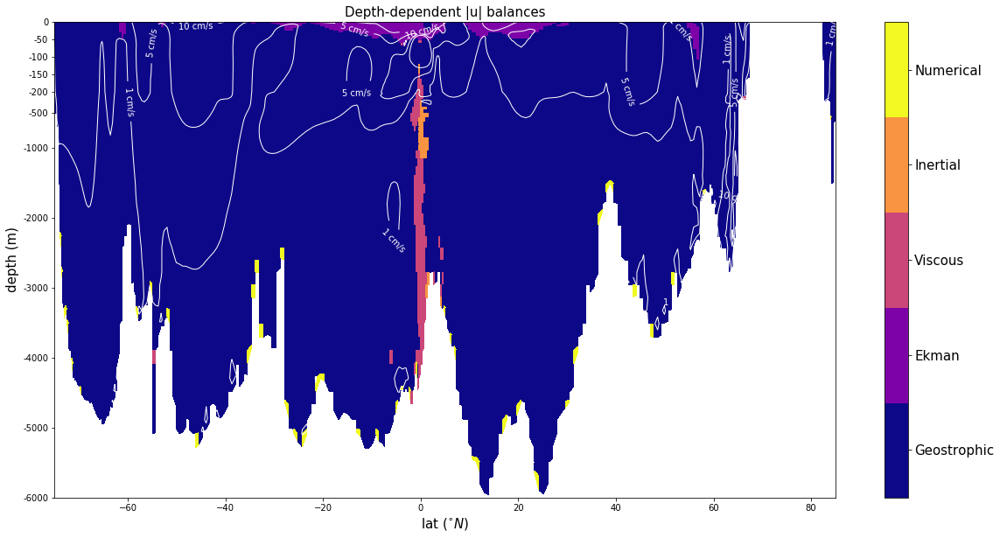

In [12]:
title='Depth-dependent |u| balances'
file='U_balances'

cbar=vertical_section(y_Atl,z_Atl,
    balances.utrd_balances.isel(x=ind_Atl)*meshmask.tmask_nan.isel(x=ind_Atl),
    levs5,unit,ylab,zlab,title,colorbar,file,frame)
cbar.set_ticks(range(0,5))
cbar.set_ticklabels(["Geostrophic","Ekman","Viscous","Inertial","Numerical"])
section_contour(y_Atl,z_Atl_stretch,u_norm_Atl,levs_u_norm,file)

# Fraction of each balance:
for i in range(0,6):
    print(np.nansum(xr.where(balances.utrd_balances.isel(x=ind_Atl)==i,
                             meshmask.e1t.isel(x=ind_Atl).data*meshmask.e3t_0.isel(x=ind_Atl).data,np.nan))
          /np.nansum(meshmask.e1t.isel(x=ind_Atl)*meshmask.e3t_0.isel(x=ind_Atl)*meshmask.tmask.isel(x=ind_Atl)))

## Depth-integral momentum balance

/home/waldmanr/Bureau/Model/VoBiN/plot/plot_methods.py:65: RuntimeWarning: invalid value encountered in less
  u_rot, v_rot = proj.transform_vectors(src_crs,x,y,u/np.cos(y/180*np.pi),v)
/home/waldmanr/Bureau/Model/VoBiN/plot/plot_methods.py:65: RuntimeWarning: invalid value encountered in greater
  u_rot, v_rot = proj.transform_vectors(src_crs,x,y,u/np.cos(y/180*np.pi),v)
/home/waldmanr/Bureau/Model/VoBiN/plot/plot_methods.py:66: RuntimeWarning: invalid value encountered in true_divide
  renorm = np.sqrt((u**2 + v**2) / (u_rot**2 + v_rot**2))
/usr/lib/python3/dist-packages/cartopy/mpl/geoaxes.py:1752: RuntimeWarning: invalid value encountered in less
  u, v = self.projection.transform_vectors(t, x, y, u, v)
/usr/lib/python3/dist-packages/cartopy/mpl/geoaxes.py:1752: RuntimeWarning: invalid value encountered in greater
  u, v = self.projection.transform_vectors(t, x, y, u, v)


0.8996248575699604
0.054295725732342925
0.0010181534913451763
0.0006860913387100324
0.007094812060168928
0.0


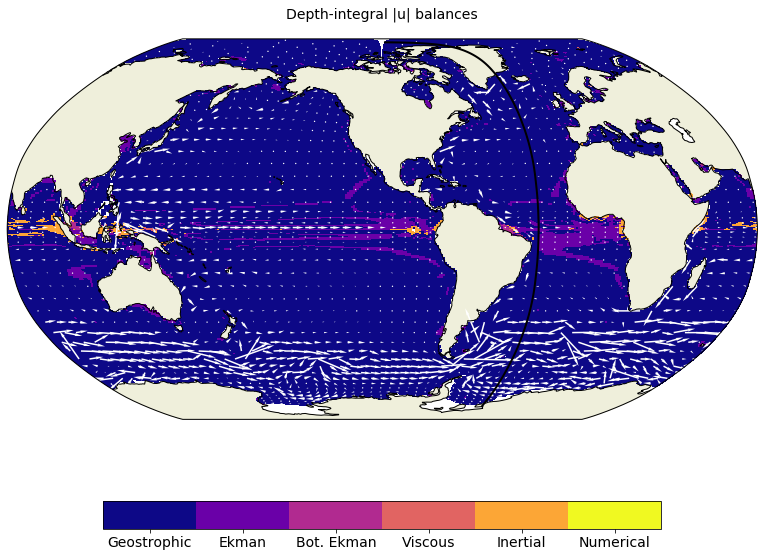

In [13]:
# Figure properties:
title='Depth-integral |u| balances'
file='U_int_balances'

# Depth-integral momentum balances
ax,cbar=global_map(x,y,balances.utrd_int_balances*meshmask.tmask_nan.isel(lev=0),levs6,unit,title,colorbar,file,projection)
cbar.set_ticks(range(0,6))
cbar.set_ticklabels(["Geostrophic","Ekman","Bot. Ekman","Viscous","Inertial","Numerical"])
atl_line(ax,x_Atl.isel(lev=0),y_Atl.isel(lev=0),file)
global_quiver(ax,x,y,u_int,v_int,file,'w')

# Fraction of each balance:
for i in range(0,6):
    print(np.nansum(meshmask.e1t.data[balances.utrd_int_balances.data==i]
                    *meshmask.e2t.data[balances.utrd_int_balances.data==i])
          /np.nansum(meshmask.e1t*meshmask.e2t*meshmask.tmask.isel(lev=0)))

## Depth-dependent vorticity balance

0.24622896345442474
0.017677683519577884
0.40172723214145145
0.01999399965835593
0.19904503223500264
0.03127110970354236


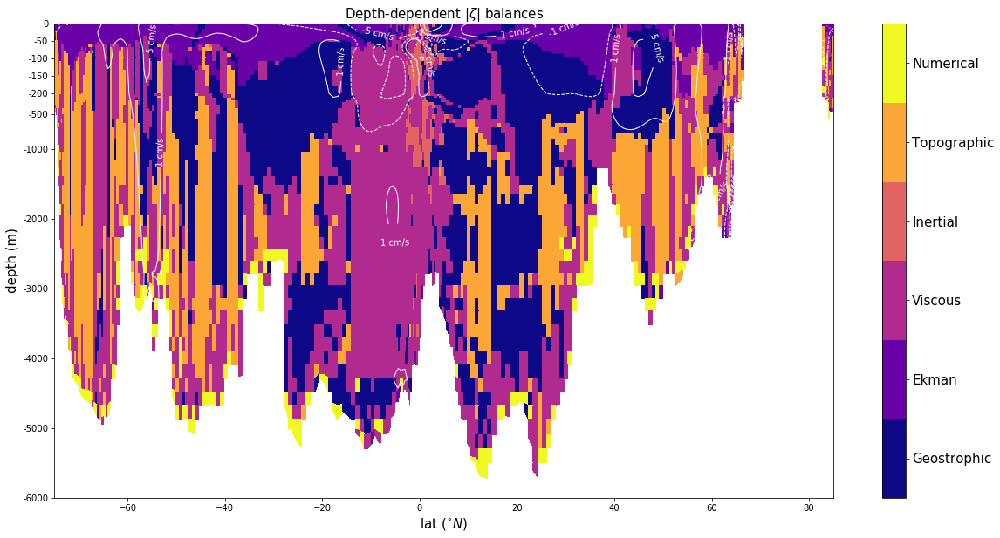

In [14]:
title='Depth-dependent |$\zeta$| balances'
file='Z_balances'

cbar=vertical_section(y_Atl,z_Atl,
    balances.ztrd_balances.isel(x=ind_Atl)*meshmask.tmask_nan.isel(x=ind_Atl),
    levs6,unit,ylab,zlab,title,colorbar,file,frame)
section_contour(y_Atl,z_Atl_stretch,v_Atl,levs_v_yz,file)
cbar.set_ticks(range(0,6))
cbar.set_ticklabels(["Geostrophic","Ekman","Viscous","Inertial","Topographic","Numerical"])
plt.savefig(file+'_smooth.png')

# Fraction of each balance:
for i in range(0,6):
    print(np.nansum(xr.where(balances.ztrd_balances.isel(x=ind_Atl)==i,
                             meshmask.e1t.isel(x=ind_Atl).data*meshmask.e3t_0.isel(x=ind_Atl).data,np.nan))
          /np.nansum(meshmask.e1t.isel(x=ind_Atl)*meshmask.e3t_0.isel(x=ind_Atl)*meshmask.tmask.isel(x=ind_Atl)))

## Depth-integral vorticity balance

<ipython-input-15-1f56b4fe4242>:16: RuntimeWarning: invalid value encountered in less
  /np.nansum(meshmask.e1t.data[balances.ztrd_int_balances.data<6]
<ipython-input-15-1f56b4fe4242>:17: RuntimeWarning: invalid value encountered in less
  *meshmask.e2t.data[balances.ztrd_int_balances.data<6]))


0.420976159687037
0.017364739379911908
0.24093708092706587
0.050489231629540235
0.22851622296244084
0.04171656541400396


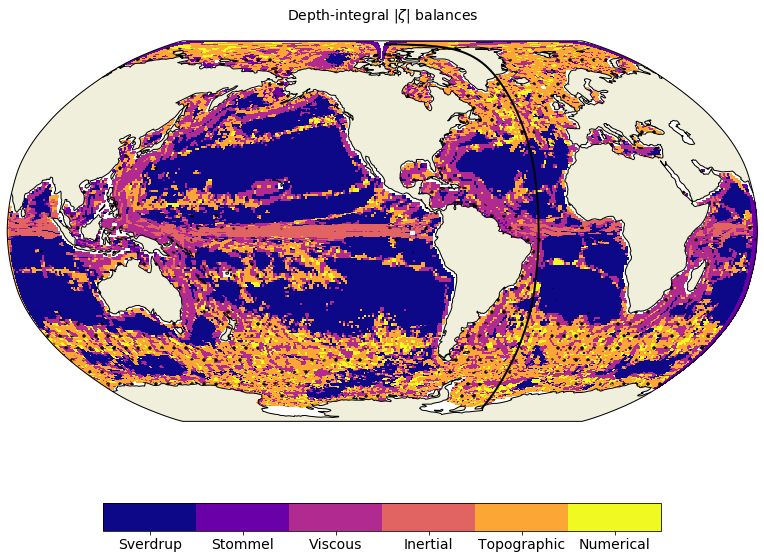

In [15]:
# Depth-integral vorticity balances
title='Depth-integral $|\zeta|$ balances'
file='Z_int_balances'

ax,cbar=global_map(x,y,balances.ztrd_int_balances,levs6,unit,title,colorbar,file,projection)
cbar.set_ticks(range(0,6))
cbar.set_ticklabels(["Sverdrup","Stommel","Viscous","Inertial","Topographic","Numerical"])
plt.savefig(file+'.png')
atl_line(ax,x_Atl.isel(lev=0),y_Atl.isel(lev=0),file)
global_hatching(ax,x,y,u_bot,levs_ubot,file)

# Fraction of each balance:
for i in range(0,6):
    print(np.nansum(meshmask.e1t.data[balances.ztrd_int_balances.data==i]
                    *meshmask.e2t.data[balances.ztrd_int_balances.data==i])
          /np.nansum(meshmask.e1t.data[balances.ztrd_int_balances.data<6]
                     *meshmask.e2t.data[balances.ztrd_int_balances.data<6]))

## Barotropic vorticity balance

<ipython-input-16-7b88f390703e>:14: RuntimeWarning: invalid value encountered in less
  /np.nansum(meshmask.e1t.data[balances.curl_utrd_int_balances.data<6]
<ipython-input-16-7b88f390703e>:15: RuntimeWarning: invalid value encountered in less
  *meshmask.e2t.data[balances.curl_utrd_int_balances.data<6]))


0.35987593777384214
0.0009678413767698194
0.13574127058669966
0.042177094791018936
0.21754278314439215
0.2436950723272772


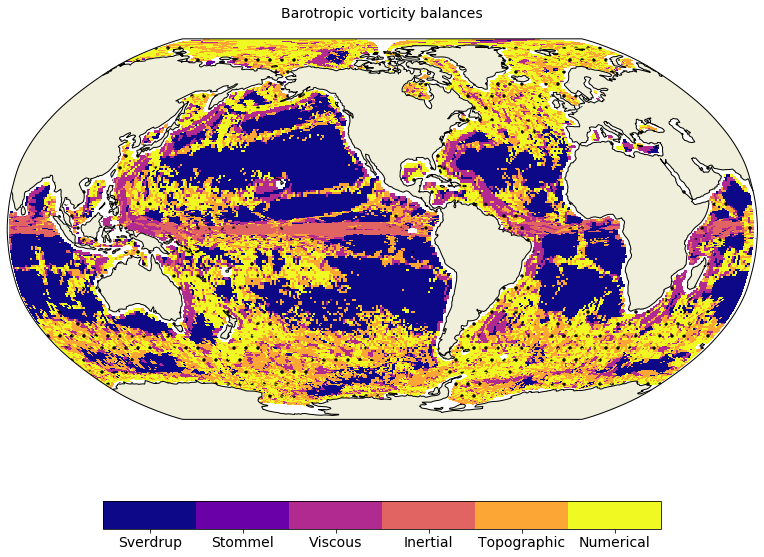

In [16]:
# Barotropic vorticity balances
title='Barotropic vorticity balances'
file='BV_balances'

ax,cbar=global_map(x,y,balances.curl_utrd_int_balances,levs6,unit,title,colorbar,file,projection)
cbar.set_ticks(range(0,6))
cbar.set_ticklabels(["Sverdrup","Stommel","Viscous","Inertial","Topographic","Numerical"])
global_hatching(ax,x,y,u_bot,levs_ubot,file)

# Fraction of each balance:
for i in range(0,6):
    print(np.nansum(meshmask.e1t.data[balances.curl_utrd_int_balances.data==i]
                    *meshmask.e2t.data[balances.curl_utrd_int_balances.data==i])
          /np.nansum(meshmask.e1t.data[balances.curl_utrd_int_balances.data<6]
                     *meshmask.e2t.data[balances.curl_utrd_int_balances.data<6]))

## Balance for the vorticity of the depth-average momentum equation

/home/waldmanr/Bureau/Model/VoBiN/plot/plot_methods.py:65: RuntimeWarning: invalid value encountered in less
  u_rot, v_rot = proj.transform_vectors(src_crs,x,y,u/np.cos(y/180*np.pi),v)
/home/waldmanr/Bureau/Model/VoBiN/plot/plot_methods.py:65: RuntimeWarning: invalid value encountered in greater
  u_rot, v_rot = proj.transform_vectors(src_crs,x,y,u/np.cos(y/180*np.pi),v)
/home/waldmanr/Bureau/Model/VoBiN/plot/plot_methods.py:66: RuntimeWarning: invalid value encountered in true_divide
  renorm = np.sqrt((u**2 + v**2) / (u_rot**2 + v_rot**2))
/usr/lib/python3/dist-packages/cartopy/mpl/geoaxes.py:1752: RuntimeWarning: invalid value encountered in less
  u, v = self.projection.transform_vectors(t, x, y, u, v)
/usr/lib/python3/dist-packages/cartopy/mpl/geoaxes.py:1752: RuntimeWarning: invalid value encountered in greater
  u, v = self.projection.transform_vectors(t, x, y, u, v)
<ipython-input-17-7d65d3902ccd>:16: RuntimeWarning: invalid value encountered in less
  /np.nansum(meshmask.e1t.

0.11466440782364466
0.0015912944880586324
0.0340727887372738
0.03001962665346139
0.44517830689576865
0.37447357540179316


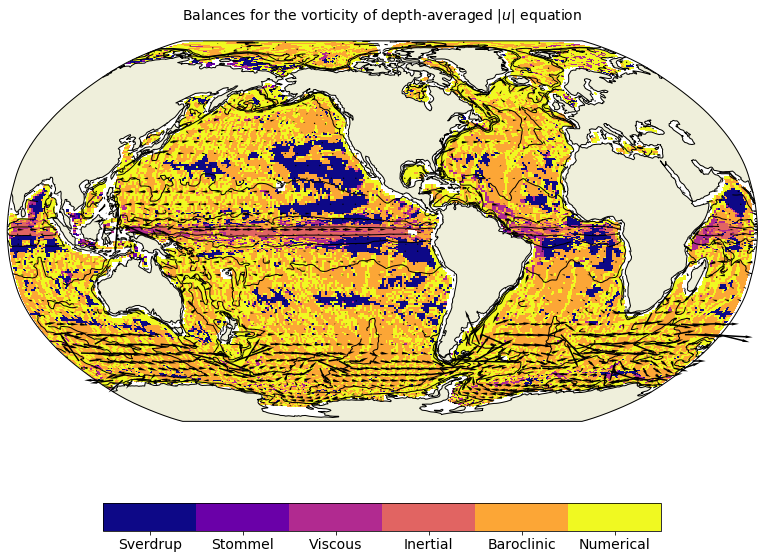

In [17]:
# Vorticity of the depth-averaged momentum balance
title='Balances for the vorticity of depth-averaged $|u|$ equation'
file='Z_av_balances'

ax,cbar=global_map(x,y,balances.curl_utrd_av_balances,levs6,unit,title,colorbar,file,projection)
cbar.set_ticks(range(0,6))
cbar.set_ticklabels(["Sverdrup","Stommel","Viscous","Inertial","Baroclinic","Numerical"])
plt.savefig(file+'.png')
global_quiver(ax,x,y,u_int,v_int,file,'k')
global_contour(ax,x,y,fh_log,levs_fh,'',file,'k')

# Fraction of each balance:
for i in range(0,6):
    print(np.nansum(meshmask.e1t.data[balances.curl_utrd_av_balances.data==i]
                    *meshmask.e2t.data[balances.curl_utrd_av_balances.data==i])
          /np.nansum(meshmask.e1t.data[balances.curl_utrd_av_balances.data<6]
                     *meshmask.e2t.data[balances.curl_utrd_av_balances.data<6]))

## Balance for the vorticity of the transport momentum equation

<ipython-input-18-abd1d4e0f719>:15: RuntimeWarning: invalid value encountered in less
  /np.nansum(meshmask.e1t.data[balances.curl_utrd_transp_balances.data<6]
<ipython-input-18-abd1d4e0f719>:16: RuntimeWarning: invalid value encountered in less
  *meshmask.e2t.data[balances.curl_utrd_transp_balances.data<6]))


0.40572976946887596
0.0015081729315177552
0.22352865973671726
0.03629387917160464
0.33293951869128435
0.0


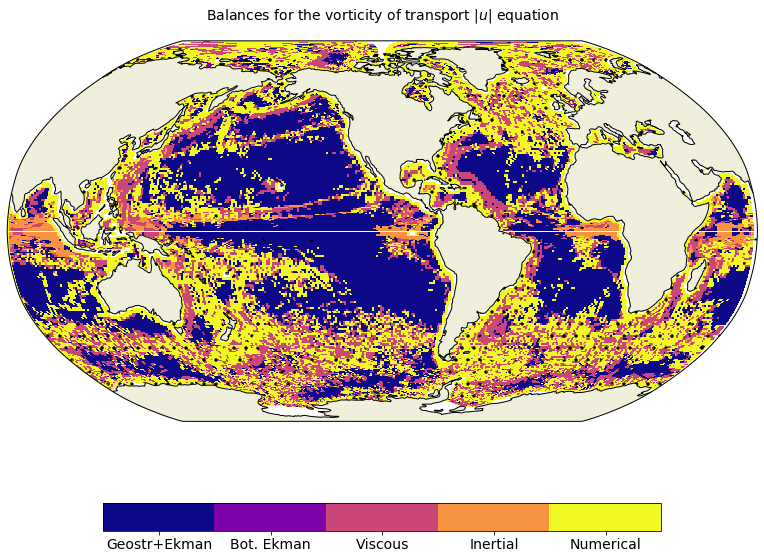

In [18]:
# Depth-integral vorticity balances
title='Balances for the vorticity of transport $|u|$ equation'
file='Z_transp_balances'

ax,cbar=global_map(x,y,balances.curl_utrd_transp_balances,levs5,unit,title,colorbar,file,projection)
cbar.set_ticks(range(0,5))
cbar.set_ticklabels(["Geostr+Ekman","Bot. Ekman","Viscous","Inertial","Numerical"])
plt.savefig(file+'.png')
global_hatching(ax,x,y,u_bot,levs_ubot,file)

# Fraction of each balance:
for i in range(0,6):
    print(np.nansum(meshmask.e1t.data[balances.curl_utrd_transp_balances.data==i]
                    *meshmask.e2t.data[balances.curl_utrd_transp_balances.data==i])
          /np.nansum(meshmask.e1t.data[balances.curl_utrd_transp_balances.data<6]
                     *meshmask.e2t.data[balances.curl_utrd_transp_balances.data<6]))